In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
#import pyrealsense2 as rs
import os
import numpy as np0
import sys
import scipy
import random
import math
import skimage.io
import datetime
import open3d as o3d

from dig_grasp.msg import stone_pose
import rospy
import geometry_msgs.msg
import time
import actionlib
from std_msgs.msg import String

import os 
import sys 

import torch
import dig_maskRCNN




# Root directory of the project
ROOT_DIR = os.path.abspath("../")

Stones_DIR = os.path.join(ROOT_DIR, "datasets/domino")

In [2]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = dig_maskRCNN.load_model(device,"../maskrcnn.pth")


#image = skimage.io.imread("../samples/stones/JPEGImages/"+img_index+".jpeg")
image = skimage.io.imread("../samples/stones/JPEGImages/3.jpeg")

plt.imshow(image)
plt.show()
        
masks = dig_maskRCNN.find_mask(image,edge_detection,device, model)

In [3]:
rospy.init_node('stone_segmentation')

In [4]:
def make_directories():
    if not os.path.exists("JPEGImages/"):
        os.makedirs("JPEGImages/")
    if not os.path.exists("depth/"):
        os.makedirs("depth/")

In [5]:
def pixel_to_camera(pixel, intrin, depth):
    #depth = depth #/ 1000
    X = (pixel[0]-intrin[0]) * depth / intrin[2]
    Y = (pixel[1]-intrin[1]) * depth / intrin[3]
    return [X, Y]

In [6]:
is_detect = 0
img_index = 0
def img_index_callback(data):
    global img_index
    global is_detect
    
    print(data.data)
    img_index = data.data
    is_detect = 1

In [7]:

rospy.Subscriber('/stone_img_index', String, img_index_callback)

In [8]:
def find_center(mask):
    g = np.mgrid[0:(mask.shape[0]),0:(mask.shape[1])]
    multiple_ = np.stack([mask,mask],0)*g
    total_sum = np.sum(multiple_,axis = (1,2))
    total_number = np.sum(mask)
    average = total_sum/total_number
    #print('mask.shape',mask.shape)
    #print('g.shape',g.shape)
    #print('total_sum',total_sum)
    #print('total_number',total_number)
    #print('average',average)
    return average.astype(int)

In [9]:
def find_depth(mask,depth_im, depth_value_percentage_taken = 25.0):   
    
    masked_depth_im = depth_im * mask
    #plt.imshow(masked_depth_im)
    #plt.show()
    depth_list = masked_depth_im[masked_depth_im > 0]
    lower_bound = np.percentile(depth_list, 50 - depth_value_percentage_taken/2)
    upper_bound = np.percentile(depth_list, 50 + depth_value_percentage_taken/2)
    
    cut_depth_list1 = depth_list[depth_list >= lower_bound]
    cut_depth_list2 = cut_depth_list1[cut_depth_list1 <= upper_bound]
    
    depth_cut_average = np.average(cut_depth_list2)
    
    #print('np.amax(depth_list)',np.amax(depth_list))
    #print('np.amin(depth_list)',np.amin(depth_list))
    #print('lower_bound',lower_bound)
    #print('upper_bound ',upper_bound )
    #print('depth_cut_average',depth_cut_average)
    #print('depth_list.shape',depth_list.shape)
    #print('cut_depth_list1.shape',cut_depth_list1.shape)
    #print(' cut_depth_list2 .shape', cut_depth_list2 .shape)
    
    depth_max = np.amin(cut_depth_list2)/1000.0
    depth = depth_cut_average/1000.0
    
    
    return depth, depth_max

In [10]:

def find_mask(im,depth_im,masks,center_point,distance_axis):
    
    #print('masks.shape',len(masks))
    
    masks = np.stack(masks,axis = -1)
    #print('masks.shape',masks.shape)
    
    mask_store = 5

    #print('center point',center_point)
    center_y, center_x = center_point
    
    mask_size = np.sum(masks,axis = (0,1))
    
    
    mask_index = np.argsort(np.array(mask_size))[-min(mask_store + 2,masks.shape[2]):-2]
    
    
    #print('mask_size',mask_size )
    #print('mask_index',mask_index)
    
    #print('mask_size[mask_index]',mask_size[mask_index])
    
    min_distance2 = 10000000000
    
    most_center_point = []
    
    most_center_mask = []
    
    #most_center_depth_max = []
    
    most_center_depth = []
    
    largest_area = 0
    
    
    for m in mask_index:
#    for m in range(seg_result['masks'].shape[2]):
        if True:#mask_size[m] < 400000:#True:#mask_size[m] < 2000 and mask_size[m] > 1600 : #>1700
            
            #print('mask_size[m]',mask_size[m])
            mask = masks[:,:,m]
            mask = mask.astype(np.uint8)
            

            ## calculate center

            [contours,hierarchy] = cv2.findContours(mask,cv2.RETR_TREE,cv2.CHAIN_APPROX_NONE)
            cnt = contours[0]
            M = cv2.moments(cnt)
            #center_point_x = int(M['m10']/M['m00'])
            #center_point_y = int(M['m01']/M['m00'])
            
            [center_point_y,center_point_x] = find_center(mask)
            
            #print('m',m)
            #print('center_point_x ',center_point_x )
            #print('center_point_y',center_point_y)

            distance2 = (center_point_x - center_x) **2 *distance_axis[1] + (
                center_point_y -center_y) **2 *distance_axis[0]


            #print(' mask')
            #print('distance2',distance2)
            #plt.imshow(mask)
            #plt.show()



    
            if distance2 < min_distance2:#True:#largest_area < mask_size[m] :#and mask_size[m] < 2000000: #
                
                largest_area = mask_size[m]
                
            
                #depth, depth_max1 = find_depth(mask,depth_im, depth_value_percentage_taken = 50.0)
                depth2, depth_max = find_depth(mask,depth_im, depth_value_percentage_taken = 90.0)
                
                depth = depth_im[center_point_y,center_point_x]/1000.0
                print('depth',depth)
                
                #print('mask')
                plt.imshow(mask)
                #plt.show()


                kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(50, 50))
                mask_dilated = cv2.dilate(mask, kernel)


                #print('mask_dilated')
                plt.imshow(mask_dilated)
                #plt.show()

                depth_env, depth_max_env = find_depth(mask_dilated,depth_im, depth_value_percentage_taken = 25.0)

                #print('depth',depth)
                #print(' depth_max_env', depth_max_env)
                #if depth_max_env > depth - 0.005 and depth_max_env < depth +0.005: #depth_max_env > depth - 0.002:
                if True:#depth_max_env > depth - 0.007 :# - 0.002 :#and  depth_max - depth  < 0.01:
                    #print('record')
                    min_distance2 = distance2 
                    most_center_point = [center_point_y,center_point_x]
                    most_center_mask = mask

                    #most_center_depth_max =  depth_max
                    most_center_depth = [depth, depth_max]




    print('most_center_point',most_center_point)
    print('most_center_mask')
    plt.imshow(most_center_mask)
    plt.show()


    
    
    img_copy = im.copy()

    cv2.circle(img_copy, (center_point[1], center_point[0]), 8, (0, 0, 255), 8)
    cv2.circle(img_copy, (most_center_point[1], most_center_point[0]), 8, (255, 0, 255), 8)
    
    #print('img_copy')
    #plt.imshow(img_copy)
    #plt.show()
    
    [contours,hierarchy] = cv2.findContours(most_center_mask,cv2.RETR_TREE,cv2.CHAIN_APPROX_NONE)
    cnt = contours[0]
    for j in range(len(contours)):
        if(len(contours[j]) > len(cnt)):
            cnt = contours[j]
    hull = cv2.convexHull(cnt,returnPoints = True)
    rect = cv2.minAreaRect(hull)
    box = cv2.boxPoints(rect)
    box = np.int0(box)
    #img_copy = im.copy()
    cv2.drawContours(img_copy,[box],0,(255,255,255),2)
    
    plt.figure(figsize=(20,10))

    
    plt.imshow(img_copy[::-1,::-1,:])#[:,:,::-1])
    plt.show()
    #print(box)
    

    return most_center_mask,most_center_point,most_center_depth,box #most_center_depth = [depth,depth_max]

In [11]:
def find_pose(depth_im, mask, center,depth,mask_box):
    
    plt.imshow((depth_im*mask) != 0)
    #plt.show()
    
    depth_intrin = [321.8862609863281, 238.18316650390625, 612.0938720703125, 611.785888671875] # cx, cy, fx, fy
    
    position = pixel_to_camera(center[::-1], depth_intrin, depth[0] )
    
    lower_point = []
    
    
    
    # Counterclockwise is positive direction
    if(np.linalg.norm(mask_box[0]-mask_box[1]) > np.linalg.norm(mask_box[1]-mask_box[2])):
        rotation = math.atan2((mask_box[2]-mask_box[1])[1], (mask_box[2]-mask_box[1])[0])
        
        ''' scaled_side_length = np.linalg.norm(mask_box[0]-mask_box[1]) /4.0
        
        direction = (mask_box[0]-mask_box[1])/np.linalg.norm(mask_box[0]-mask_box[1])
        
        
        side_points = [(center + direction*scaled_side_length).astype(int),
                       (center - direction*scaled_side_length).astype(int)]
        
        print('scaled_side_length',scaled_side_length)
        print(' side_points ',side_points)
        print(' depth_im[side_points]',depth_im[side_points])
        print(' depth_im.shape',depth_im.shape)
        
        lower_point = side_points[np.argmin(depth_im[side_points[0],side_points[1]])]
        
        '''
        
        
        
        print("rotation 111")
    else:
        rotation = math.atan2((mask_box[1]-mask_box[0])[1], (mask_box[1]-mask_box[0])[0])
        
        print("rotation 222")
        
        
        
    if rotation > math.pi:   ### reduce 180> x >360 to -180<x<0
        rotation = rotation - 2 * math.pi
        print("rotation 212")
   
    
    print('rotation,',math.degrees(rotation))
    
    pose={
            'x':position[0],
            'y':position[1],
            'z':depth[0] ,
            'yaw':rotation,
            'pitch':0,
            'normal':0
    }
    
    return pose

In [12]:
def compute_normal(depth_array0 ,mask):
    #depth_image = cv2.imread("depth/7.jpeg") #83
    #depth_array = np.load("./depth/7.npy") #83    
    
    kernel = np.ones((5,5), np.uint8)
    mask_eroded = cv2.erode(mask, kernel, iterations = 5)
    
    #depth_array  = depth_array*mask_eroded
    
    #print('depth_array0',depth_array0.shape)
    #print('mask',mask.shape)
    #print('depth_array0',depth_array0)
    
    #print(mask_eroded )
    
    #plt.imshow(depth_array0)
    #plt.show()
    plt.imshow(mask_eroded)
    #plt.show()

    depth_array = depth_array0#*mask_eroded
    #print(' depth_array', depth_array.shape)
    #print('argwhere',np.argwhere(depth_array<200))
    
    #plt.imshow( depth_array)
    #plt.show()
    
    depth_copy = depth_array#depth_image.copy()
    
    
    mask_size = []
    points = []
    point_show = []
    points_ero = []
    point_show_ero = []
    mask_store = 5
    window = 10
    depth_intrin = [321.8862609863281, 238.18316650390625, 612.0938720703125, 611.785888671875]

    point_all0 = []
    #print('points print')
    for i in range(depth_copy.shape[0]):
        for j in range(depth_copy.shape[1]):
            if mask_eroded[i, j]>0 :#and depth_array[i, j]/1000 < 0.2:   True:#
                xy = pixel_to_camera([j, i], depth_intrin, depth_array[i, j])
                point_all0.append([xy[0], xy[1], depth_array[i, j]])
                #print('point',xy)
                
    depth_average = np.mean(np.array(point_all0)[:,2])
    #depth_average = 0
    
    point_all = []
    
    for i in range(len(point_all0)):
        if point_all0[i][2] > depth_average:
            point_all.append(point_all0[i])
            
    depth = np.mean(np.array(point_all)[:,2])/1000.0
                

    pcd_all = o3d.geometry.PointCloud()
    pcd_all.points = o3d.utility.Vector3dVector(point_all)
    o3d.io.write_point_cloud("test_ros_all.ply", pcd_all)


    #NNOORRMMAALL
    #pcd_load = o3d.io.read_point_cloud("test_ros_ero_not_real.ply")
    pcd_load = o3d.io.read_point_cloud("test_ros_all.ply")
    downpcd = o3d.geometry.voxel_down_sample(pcd_load, voxel_size=1)

    color = np.array([1,0,0])
    color = np.tile(color, (67, 1)) # 67 is number of points
    downpcd.colors = o3d.utility.Vector3dVector(color)
    #o3d.visualization.draw_geometries([downpcd])

    print("Recompute the normal of the downsampled point cloud")
    o3d.geometry.estimate_normals(downpcd, search_param=o3d.geometry.KDTreeSearchParamHybrid(
        radius=10, max_nn=30))
    print("Normal as a numpy array")

    for i in range(np.asarray(downpcd.normals).shape[0]):
        if downpcd.normals[i][2] > 0:
            downpcd.normals[i][0] = -downpcd.normals[i][0]
            downpcd.normals[i][1] = -downpcd.normals[i][1]
            downpcd.normals[i][2] = -downpcd.normals[i][2]
        downpcd.normals[i] = 3 * downpcd.normals[i]

    normals = np.asarray(downpcd.normals)
    #normals = normals / np.linalg.norm(normals)
    surf_normal = np.sum(normals, axis=0) / normals.shape[0]
    #print('normals',normals)
    #print(normals.shape)
    #print(surf_normal)
    o3d.visualization.draw_geometries([downpcd])
    
    return surf_normal, depth

In [13]:
#img_index = 23
is_detect = 0
#import time

Mask R-CNN: 31 objects detected tensor([0.9912, 0.9908, 0.9905, 0.9885, 0.9884, 0.9873, 0.9868, 0.9867, 0.9867,
        0.9866, 0.9853, 0.9852, 0.9844, 0.9841, 0.9837, 0.9828, 0.9812, 0.9804,
        0.9803, 0.9798, 0.9766, 0.9744, 0.9716, 0.9701, 0.9687, 0.9646, 0.9640,
        0.9626, 0.9566, 0.9564, 0.9553, 0.9429, 0.9420, 0.9416, 0.9310, 0.9307,
        0.9293, 0.9240, 0.9237, 0.9232, 0.9213, 0.8997, 0.8925, 0.8909, 0.8795,
        0.8667, 0.8367, 0.7910, 0.7698, 0.7472, 0.7150, 0.7122, 0.6911, 0.6877,
        0.6743, 0.6590, 0.6127, 0.5363, 0.5029, 0.4869, 0.4847, 0.4711, 0.4687,
        0.4494, 0.4401, 0.4284, 0.4211, 0.3765, 0.3502, 0.3424, 0.3351, 0.3316,
        0.3214, 0.2989, 0.2700, 0.2689, 0.2660, 0.2503, 0.2381, 0.2282, 0.2242,
        0.2145, 0.2110, 0.1756, 0.1695, 0.1666, 0.1550, 0.1541, 0.1492, 0.1477,
        0.1464, 0.1434, 0.1224, 0.1219, 0.1186, 0.1182, 0.1164, 0.1142, 0.1141,
        0.1140])
time spend 0.45000243186950684
mask_objs 31


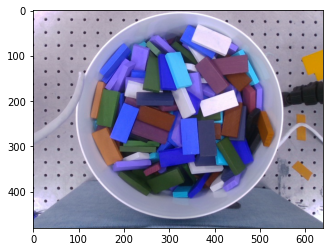

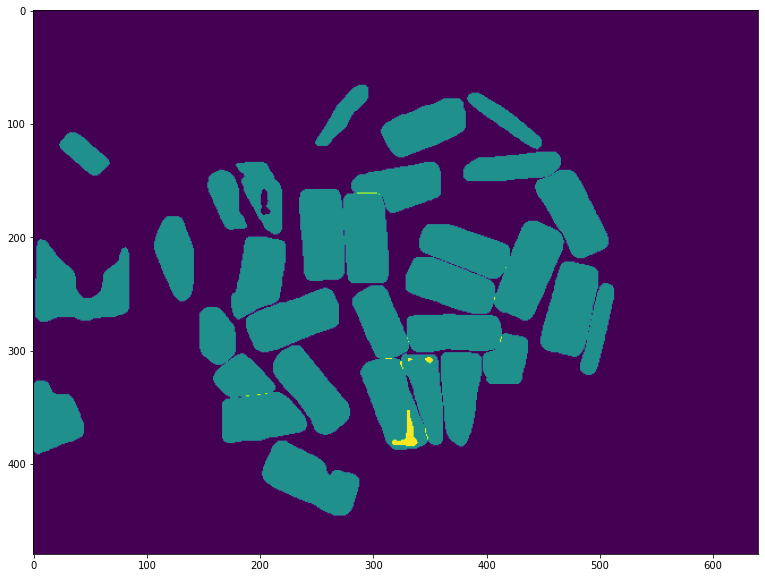

depth 0.336
most_center_point [278, 345]
most_center_mask


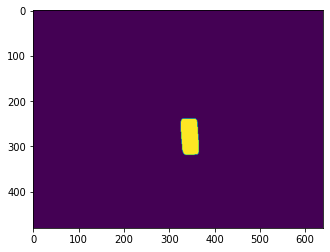

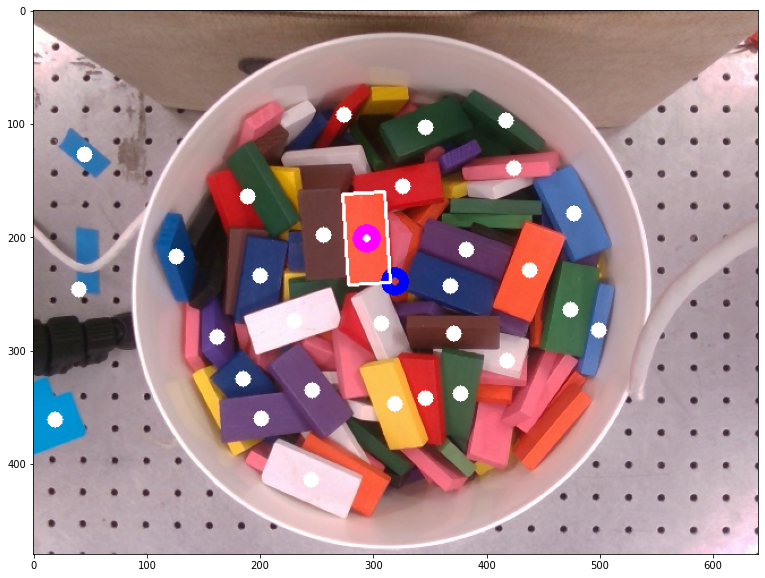

rotation 111
rotation, -3.0940580589171116
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [278, 345]
stone_pose_msg is  header: 
  seq: 72
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.012687949778562118
y: 0.021867872898688086
z: 0.336
yaw: -0.05400150037596829
pitch: 0
normal: [-0.25471254 -0.44935564 -2.93858806]
depth[1] 85.17
44
Mask R-CNN: 30 objects detected tensor([0.9910, 0.9902, 0.9890, 0.9888, 0.9880, 0.9878, 0.9878, 0.9871, 0.9862,
        0.9859, 0.9853, 0.9851, 0.9835, 0.9834, 0.9829, 0.9818, 0.9808, 0.9800,
        0.9800, 0.9791, 0.9778, 0.9746, 0.9742, 0.9730, 0.9673, 0.9650, 0.9620,
        0.9596, 0.9572, 0.9544, 0.9442, 0.9415, 0.9412, 0.9364, 0.9230, 0.9225,
        0.9219, 0.9216, 0.9099, 0.9069, 0.9054, 0.8965, 0.8957, 0.8847, 0.8832,
        0.8621, 0.8516, 0.7769, 0.7765, 0.7362, 0.7257, 0.7032, 0.7027, 0.6565,
        0.6495, 0.5956, 0.5903, 0.5677, 0.5596, 0.5416, 0.4951, 

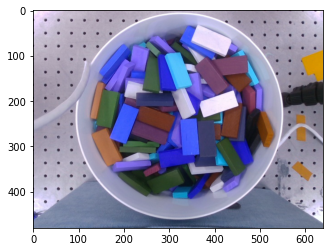

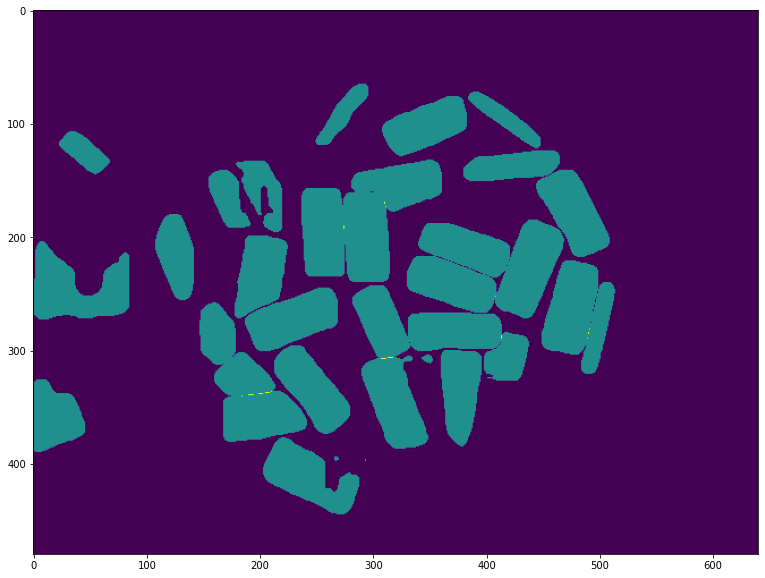

depth 0.337
depth 0.336
most_center_point [279, 345]
most_center_mask


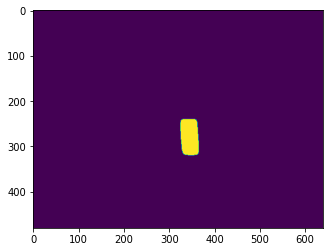

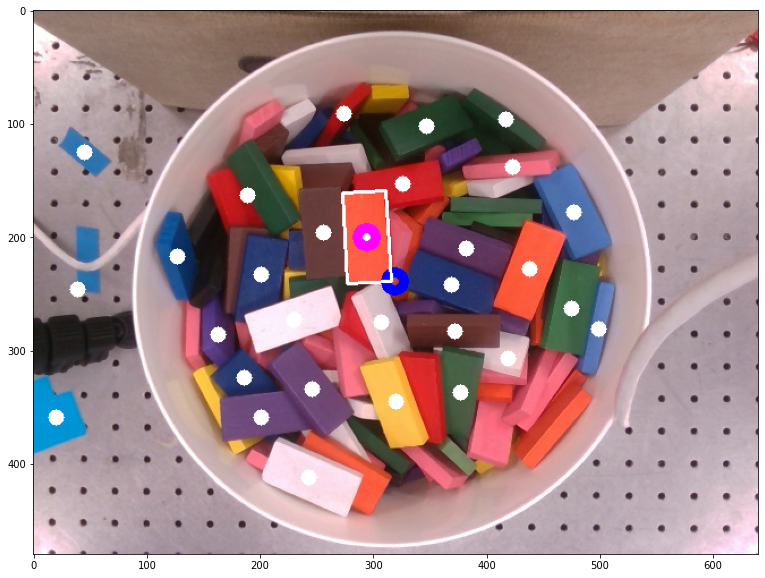

rotation 111
rotation, -2.935673446421173
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [279, 345]
stone_pose_msg is  header: 
  seq: 73
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.012687949778562118
y: 0.022417084651069986
z: 0.336
yaw: -0.05123716740341881
pitch: 0
normal: [-0.23597897 -0.41308678 -2.92940983]
depth[1] 85.17
45
Mask R-CNN: 31 objects detected tensor([0.9944, 0.9917, 0.9913, 0.9908, 0.9905, 0.9887, 0.9876, 0.9875, 0.9874,
        0.9863, 0.9861, 0.9860, 0.9857, 0.9848, 0.9836, 0.9827, 0.9776, 0.9762,
        0.9751, 0.9744, 0.9740, 0.9717, 0.9716, 0.9712, 0.9703, 0.9686, 0.9657,
        0.9641, 0.9639, 0.9532, 0.9503, 0.9479, 0.9471, 0.9460, 0.9448, 0.9341,
        0.9340, 0.9338, 0.9335, 0.9331, 0.9177, 0.9088, 0.8924, 0.8917, 0.8906,
        0.8870, 0.8775, 0.8644, 0.8604, 0.8461, 0.8257, 0.7916, 0.7784, 0.7331,
        0.7118, 0.7102, 0.6923, 0.6816, 0.6036, 0.5985, 0.5806, 0

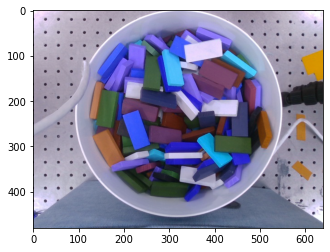

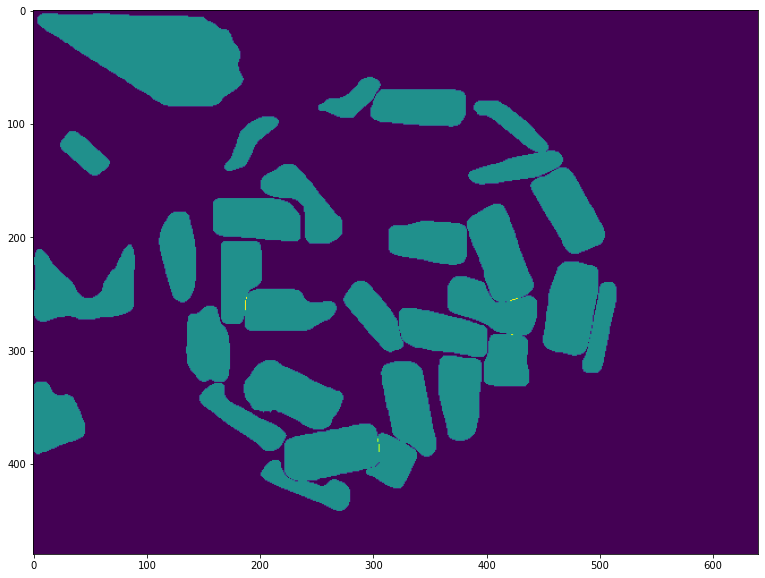

depth 0.334
depth 0.333
most_center_point [264, 227]
most_center_mask


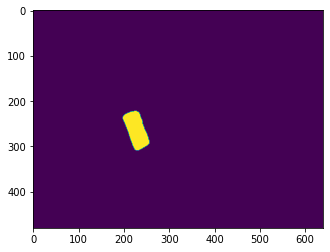

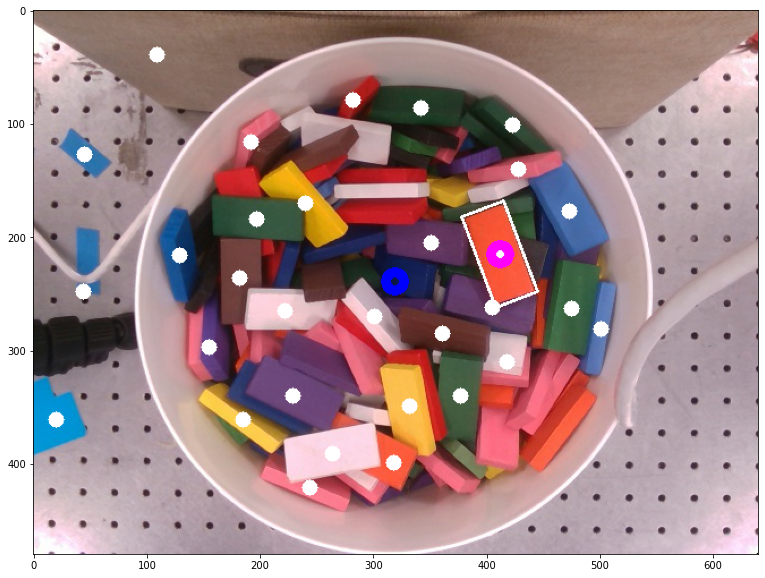

rotation 111
rotation, -20.72555886556054
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [264, 227]
stone_pose_msg is  header: 
  seq: 74
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.05162137108410332
y: 0.014052310969222328
z: 0.333
yaw: -0.36172924151993224
pitch: 0
normal: [ 0.48471093  0.15598863 -2.88645141]
depth[1] 84.15
46
Mask R-CNN: 25 objects detected tensor([0.9919, 0.9917, 0.9899, 0.9893, 0.9868, 0.9864, 0.9857, 0.9835, 0.9832,
        0.9831, 0.9830, 0.9823, 0.9798, 0.9776, 0.9773, 0.9750, 0.9747, 0.9731,
        0.9715, 0.9708, 0.9685, 0.9651, 0.9605, 0.9595, 0.9548, 0.9474, 0.9425,
        0.9422, 0.9388, 0.9372, 0.9298, 0.9256, 0.9213, 0.9111, 0.8996, 0.8924,
        0.8903, 0.8901, 0.8649, 0.8590, 0.8538, 0.8378, 0.8312, 0.8088, 0.7771,
        0.7675, 0.7445, 0.7424, 0.7368, 0.7367, 0.7271, 0.7019, 0.6476, 0.6258,
        0.6021, 0.5973, 0.5839, 0.5315, 0.4959, 0.4597, 0.4504, 0

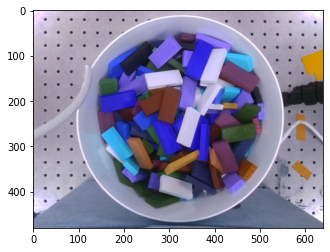

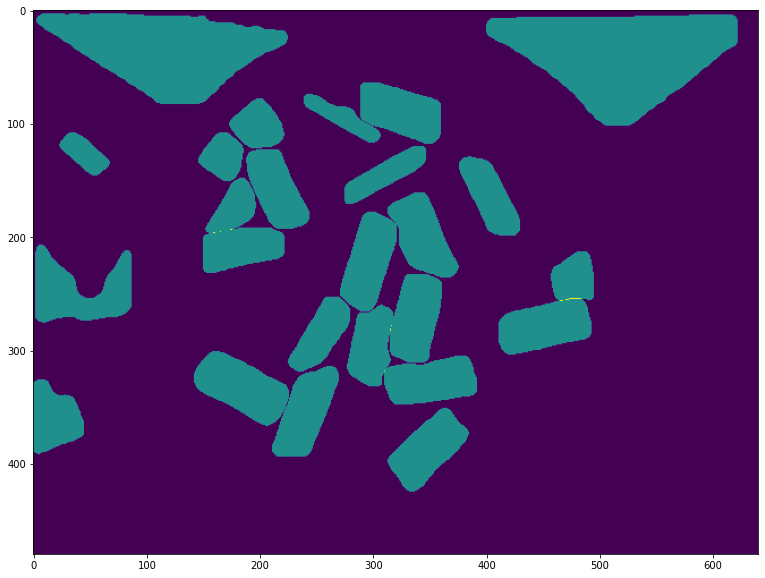

depth 0.332
depth 0.327
most_center_point [257, 342]
most_center_mask


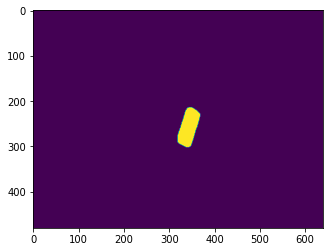

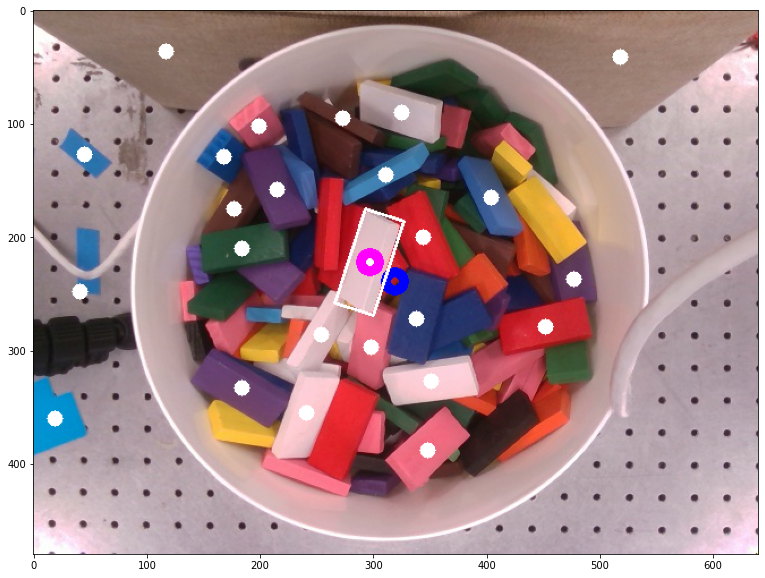

rotation 222
rotation, -162.07208023799276
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [257, 342]
stone_pose_msg is  header: 
  seq: 75
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.010745398635056368
y: 0.010057611113882377
z: 0.327
yaw: -2.8286914257094087
pitch: 0
normal: [ 2.05524882  0.04708484 -2.13214735]
depth[1] 82.365
47
Mask R-CNN: 28 objects detected tensor([0.9935, 0.9922, 0.9903, 0.9901, 0.9896, 0.9895, 0.9851, 0.9851, 0.9849,
        0.9836, 0.9831, 0.9826, 0.9824, 0.9820, 0.9817, 0.9805, 0.9767, 0.9747,
        0.9740, 0.9723, 0.9704, 0.9681, 0.9667, 0.9658, 0.9653, 0.9645, 0.9621,
        0.9584, 0.9454, 0.9410, 0.9388, 0.9372, 0.9303, 0.8941, 0.8642, 0.8539,
        0.8475, 0.8132, 0.7708, 0.7653, 0.7606, 0.7426, 0.7344, 0.7105, 0.6899,
        0.6396, 0.6385, 0.6370, 0.5879, 0.5702, 0.5596, 0.5551, 0.5457, 0.5018,
        0.4606, 0.4355, 0.4148, 0.3825, 0.3818, 0.3787, 0.3658, 

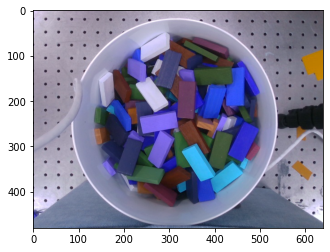

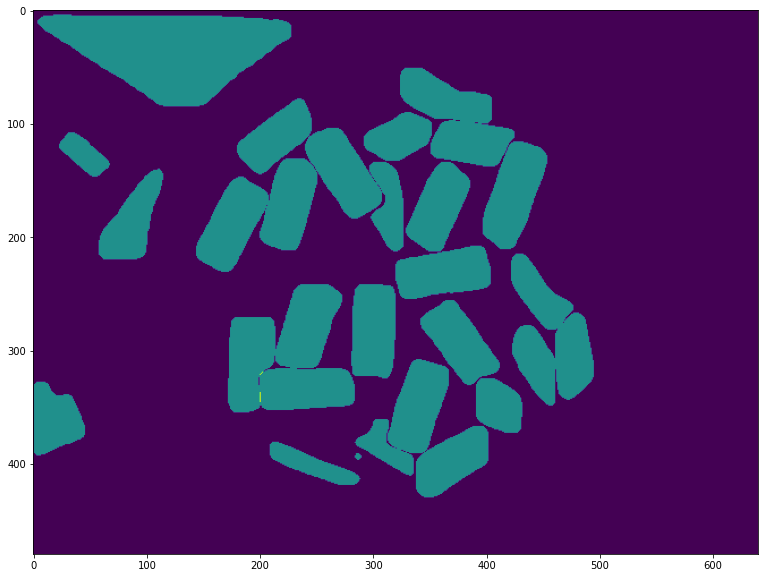

depth 0.328
depth 0.337
most_center_point [247, 276]
most_center_mask


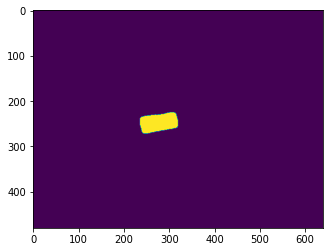

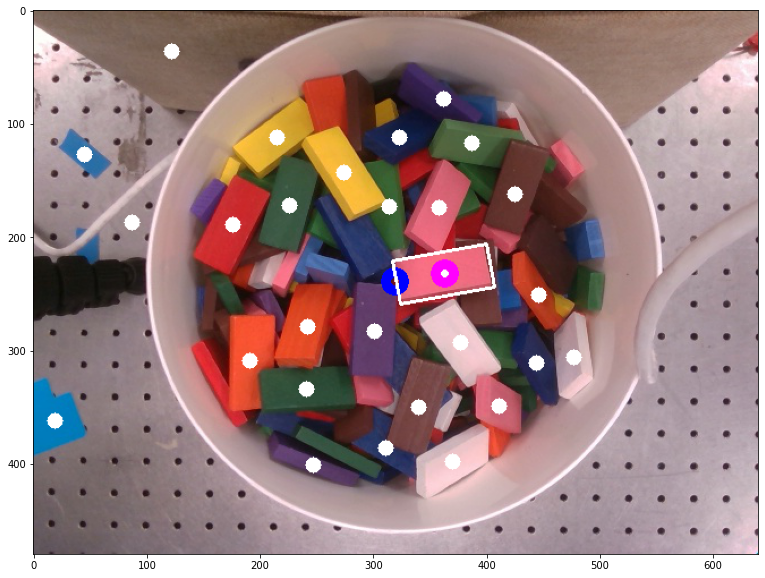

rotation 222
rotation, -100.4374753511182
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [247, 276]
stone_pose_msg is  header: 
  seq: 76
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.02526355949307108
y: 0.004856720207512347
z: 0.337
yaw: -1.7529646372676602
pitch: 0
normal: [ 0.30269306  0.98958696 -2.80780364]
depth[1] 84.915
48
Mask R-CNN: 28 objects detected tensor([0.9938, 0.9924, 0.9914, 0.9884, 0.9857, 0.9857, 0.9851, 0.9846, 0.9846,
        0.9838, 0.9834, 0.9826, 0.9824, 0.9816, 0.9810, 0.9807, 0.9784, 0.9781,
        0.9769, 0.9754, 0.9736, 0.9669, 0.9617, 0.9590, 0.9582, 0.9576, 0.9547,
        0.9527, 0.9459, 0.9424, 0.9401, 0.9360, 0.9101, 0.9069, 0.8683, 0.8604,
        0.8603, 0.8394, 0.7811, 0.7605, 0.7574, 0.7204, 0.7200, 0.7081, 0.6854,
        0.6677, 0.6411, 0.6156, 0.5588, 0.5535, 0.5245, 0.5079, 0.5012, 0.4890,
        0.4733, 0.4728, 0.3892, 0.3856, 0.3692, 0.3665, 0.3646, 0

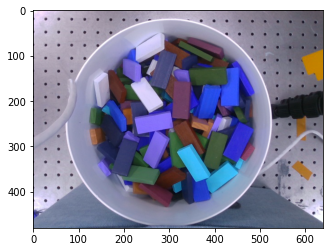

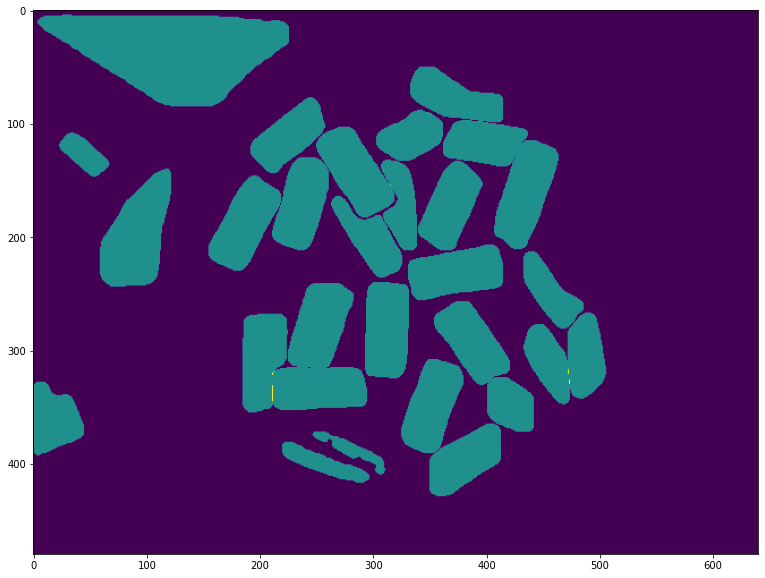

depth 0.333
depth 0.336
depth 0.327
most_center_point [197, 327]
most_center_mask


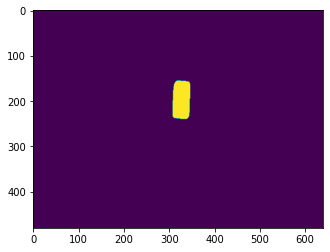

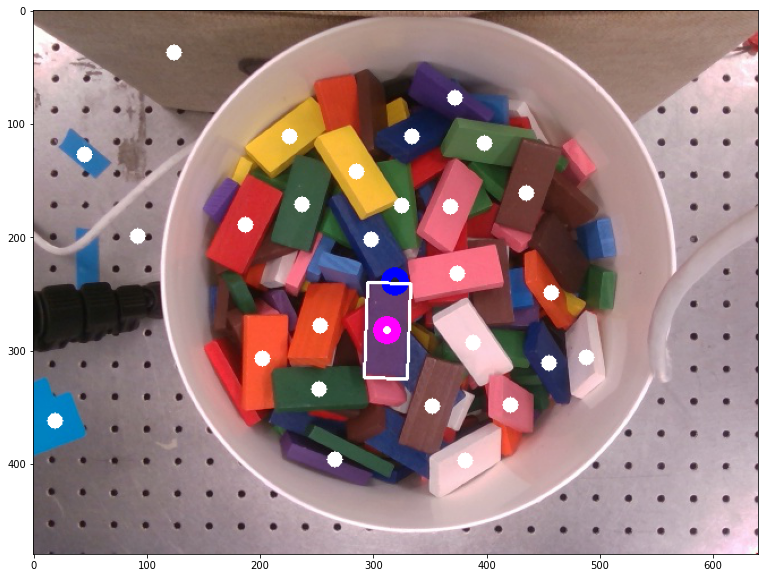

rotation 222
rotation, -178.49256424122504
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [197, 327]
stone_pose_msg is  header: 
  seq: 77
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.002731921905727909
y: -0.022012432284132293
z: 0.327
yaw: -3.1152829363368713
pitch: 0
normal: [-0.7956551   0.24409113 -2.87477593]
depth[1] 82.62
49
Mask R-CNN: 34 objects detected tensor([0.9914, 0.9913, 0.9912, 0.9911, 0.9896, 0.9891, 0.9886, 0.9876, 0.9866,
        0.9862, 0.9834, 0.9823, 0.9815, 0.9811, 0.9808, 0.9803, 0.9790, 0.9789,
        0.9784, 0.9754, 0.9752, 0.9738, 0.9730, 0.9706, 0.9697, 0.9685, 0.9685,
        0.9638, 0.9628, 0.9623, 0.9596, 0.9591, 0.9547, 0.9543, 0.9455, 0.9377,
        0.9362, 0.9315, 0.9246, 0.9086, 0.8909, 0.8264, 0.8258, 0.7842, 0.7837,
        0.7809, 0.7779, 0.7629, 0.7483, 0.7048, 0.6608, 0.6139, 0.6110, 0.5955,
        0.5863, 0.5581, 0.5536, 0.5473, 0.5216, 0.4862, 0.4757, 

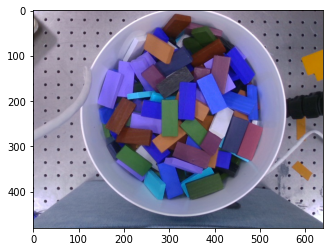

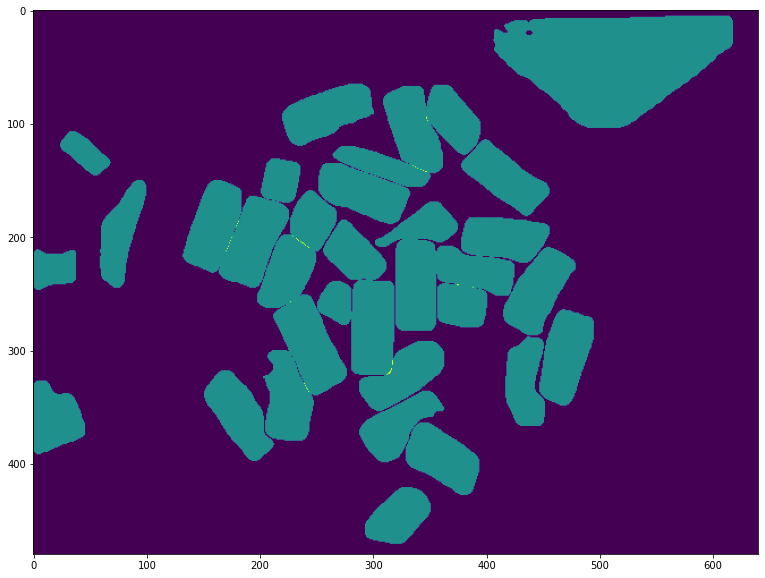

depth 0.341
depth 0.332
most_center_point [236, 301]
most_center_mask


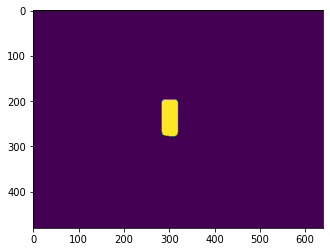

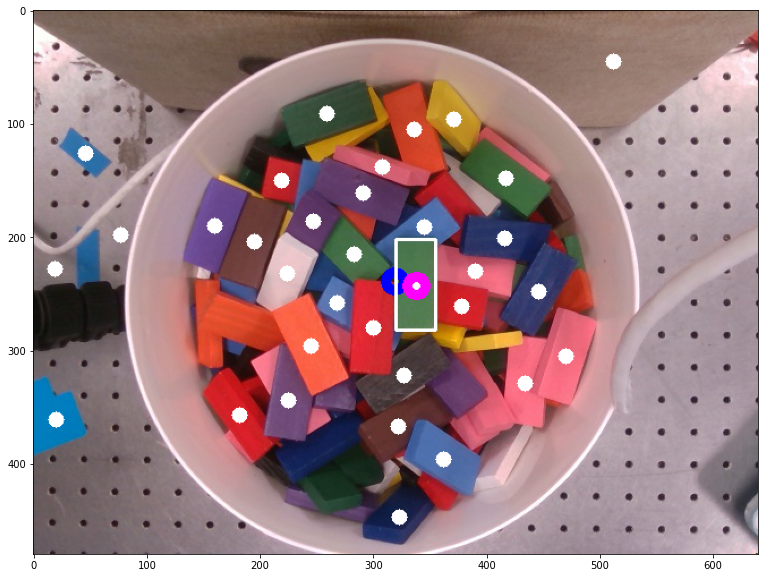

rotation 222
rotation, 180.0
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [236, 301]
stone_pose_msg is  header: 
  seq: 78
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.011328717642617385
y: -0.0011847466453833492
z: 0.332
yaw: 3.141592653589793
pitch: 0
normal: [ 0.35001556  0.31945602 -2.89991092]
depth[1] 84.15
50
Mask R-CNN: 32 objects detected tensor([0.9910, 0.9900, 0.9891, 0.9890, 0.9887, 0.9867, 0.9834, 0.9819, 0.9809,
        0.9798, 0.9795, 0.9781, 0.9772, 0.9763, 0.9760, 0.9755, 0.9739, 0.9726,
        0.9719, 0.9710, 0.9705, 0.9703, 0.9692, 0.9688, 0.9652, 0.9640, 0.9635,
        0.9634, 0.9617, 0.9613, 0.9549, 0.9516, 0.9465, 0.9428, 0.9402, 0.9361,
        0.9343, 0.9123, 0.9038, 0.8901, 0.8826, 0.8803, 0.8450, 0.8409, 0.8273,
        0.8053, 0.7835, 0.7643, 0.7394, 0.6422, 0.6223, 0.6120, 0.5924, 0.5584,
        0.5068, 0.4885, 0.4848, 0.4746, 0.4663, 0.4346, 0.4239, 0.3960, 0.3294

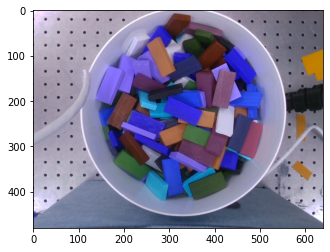

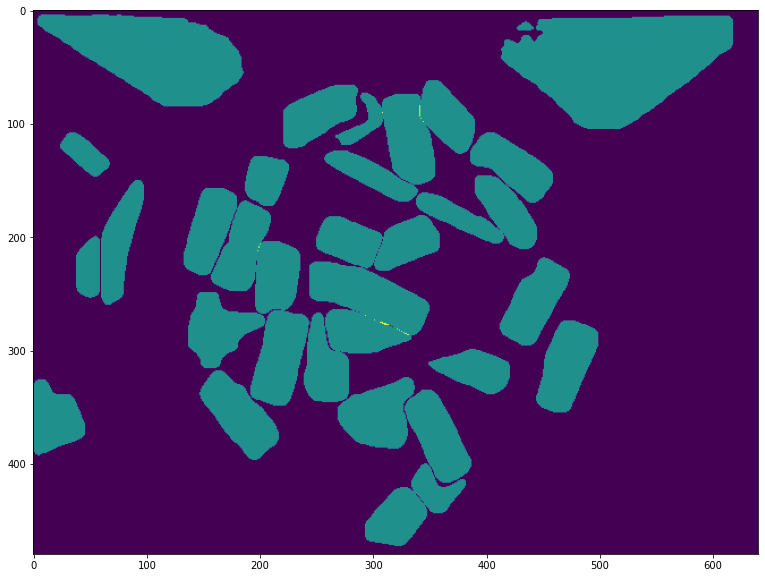

depth 0.329
depth 0.335
depth 0.337
most_center_point [227, 343]
most_center_mask


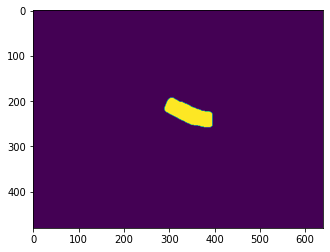

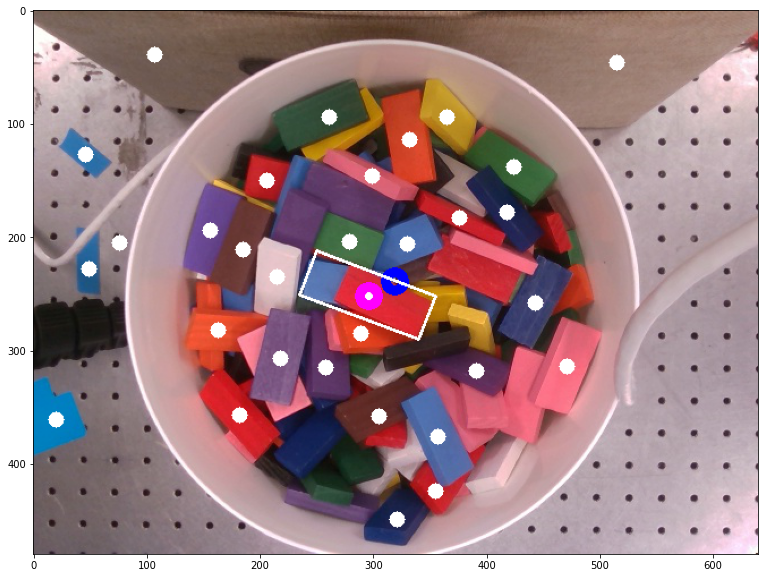

rotation 111
rotation, -68.45902408146156
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [227, 343]
stone_pose_msg is  header: 
  seq: 79
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.011624573243219905
y: -0.006160206015862723
z: 0.337
yaw: -1.194835372923591
pitch: 0
normal: [ 0.70190977  0.65769803 -2.67071494]
depth[1] 85.68
51
Mask R-CNN: 30 objects detected tensor([0.9896, 0.9889, 0.9888, 0.9880, 0.9869, 0.9864, 0.9852, 0.9843, 0.9838,
        0.9833, 0.9831, 0.9776, 0.9755, 0.9753, 0.9737, 0.9727, 0.9722, 0.9700,
        0.9672, 0.9665, 0.9661, 0.9655, 0.9653, 0.9645, 0.9641, 0.9624, 0.9614,
        0.9582, 0.9505, 0.9503, 0.9485, 0.9423, 0.9314, 0.9209, 0.9205, 0.9176,
        0.9165, 0.9072, 0.9042, 0.8550, 0.8473, 0.8434, 0.8195, 0.7964, 0.7899,
        0.7667, 0.7544, 0.7377, 0.7343, 0.6869, 0.6818, 0.6528, 0.5981, 0.5668,
        0.4943, 0.4553, 0.4503, 0.4480, 0.4412, 0.3731, 0.3650, 0.

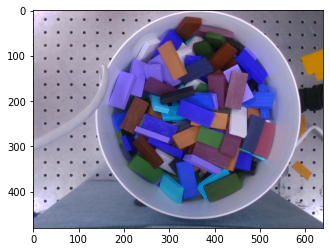

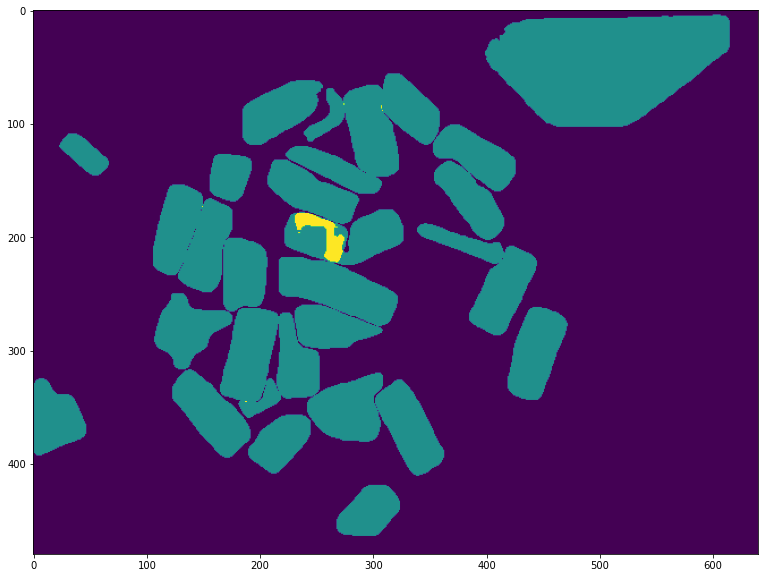

depth 0.337
depth 0.33
depth 0.335
most_center_point [126, 360]
most_center_mask


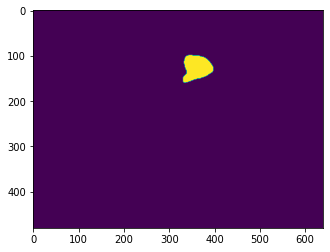

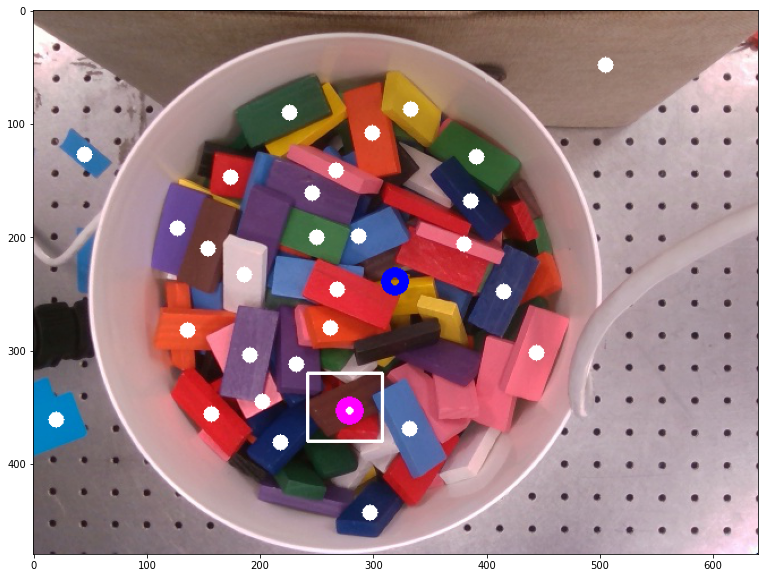

rotation 111
rotation, -90.0
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [126, 360]
stone_pose_msg is  header: 
  seq: 80
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.020859713112947778
y: -0.061428943482815385
z: 0.335
yaw: -1.5707963267948966
pitch: 0
normal: [-0.81305696  1.81766544 -1.93755505]
depth[1] 83.385
52
Mask R-CNN: 30 objects detected tensor([0.9909, 0.9907, 0.9907, 0.9896, 0.9895, 0.9885, 0.9869, 0.9847, 0.9842,
        0.9827, 0.9824, 0.9821, 0.9796, 0.9794, 0.9782, 0.9755, 0.9752, 0.9739,
        0.9716, 0.9713, 0.9670, 0.9669, 0.9664, 0.9649, 0.9623, 0.9553, 0.9551,
        0.9544, 0.9518, 0.9506, 0.9404, 0.9401, 0.9399, 0.9384, 0.9382, 0.9156,
        0.9148, 0.9109, 0.9054, 0.9046, 0.9030, 0.8995, 0.8736, 0.8567, 0.8289,
        0.8252, 0.8068, 0.8009, 0.7766, 0.7428, 0.7318, 0.7204, 0.6307, 0.5891,
        0.5022, 0.4812, 0.4788, 0.4664, 0.4165, 0.3896, 0.3785, 0.3702, 0.362

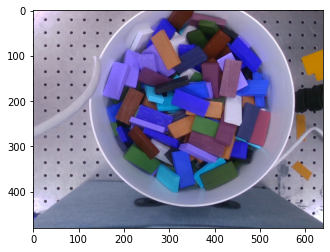

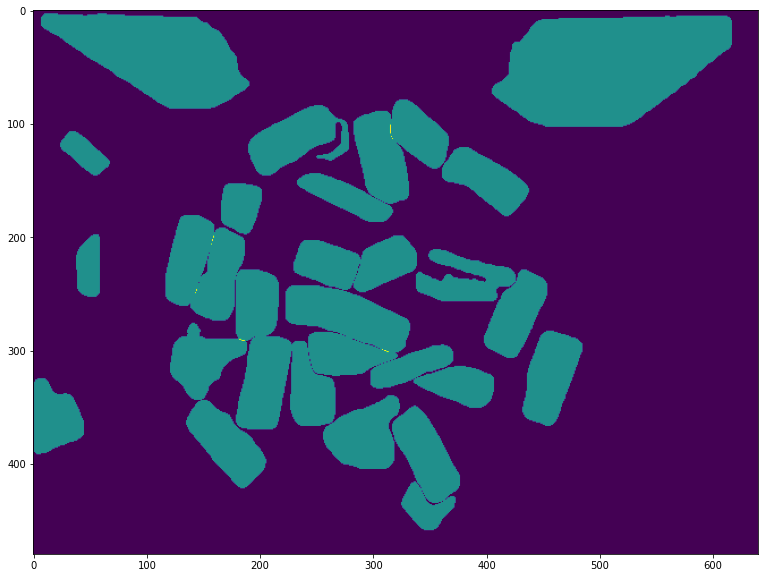

depth 0.329
depth 0.336
depth 0.337
most_center_point [209, 362]
most_center_mask


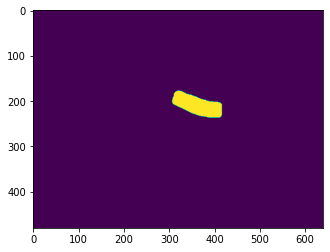

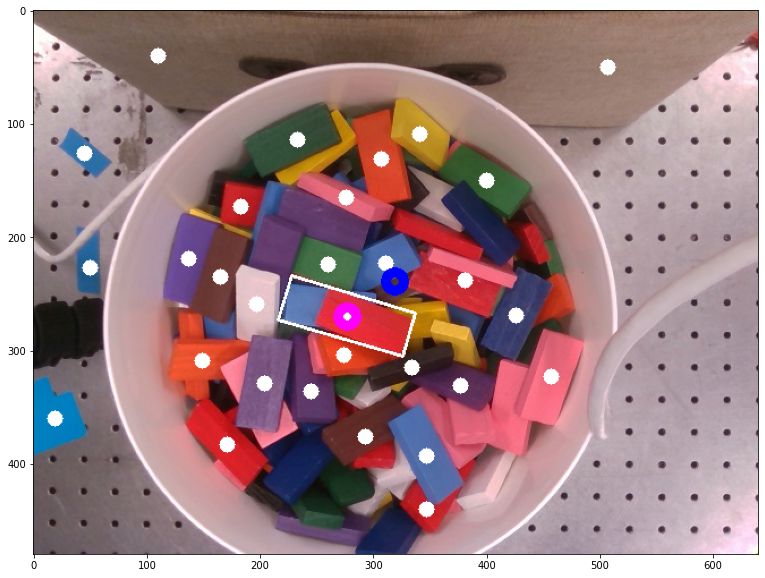

rotation 111
rotation, -73.85566121971652
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [209, 362]
stone_pose_msg is  header: 
  seq: 81
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.022085387004257648
y: -0.016075439616900288
z: 0.337
yaw: -1.2890244595215445
pitch: 0
normal: [ 0.41903479  0.67122401 -2.73140718]
depth[1] 85.68
53
Mask R-CNN: 33 objects detected tensor([0.9937, 0.9936, 0.9917, 0.9904, 0.9885, 0.9885, 0.9877, 0.9876, 0.9861,
        0.9828, 0.9808, 0.9806, 0.9805, 0.9803, 0.9794, 0.9778, 0.9774, 0.9771,
        0.9769, 0.9763, 0.9752, 0.9742, 0.9730, 0.9701, 0.9673, 0.9672, 0.9664,
        0.9658, 0.9624, 0.9598, 0.9551, 0.9532, 0.9524, 0.9495, 0.9463, 0.9322,
        0.9081, 0.8990, 0.8827, 0.8775, 0.8647, 0.8537, 0.8451, 0.8270, 0.8236,
        0.8009, 0.7987, 0.7862, 0.7775, 0.7679, 0.7576, 0.7294, 0.6484, 0.6372,
        0.6269, 0.6255, 0.5719, 0.5139, 0.4663, 0.4356, 0.4331, 0

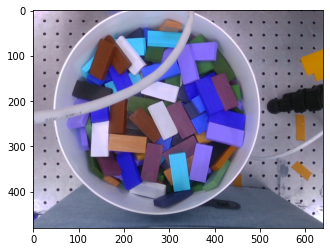

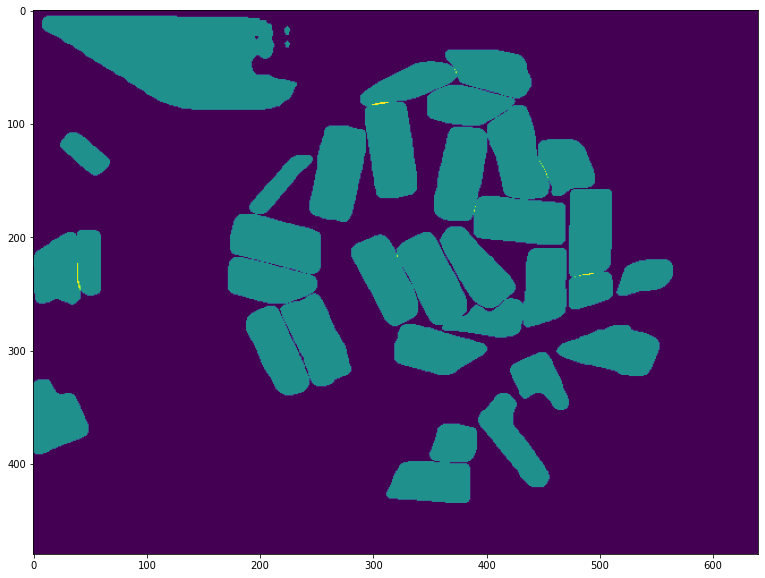

depth 0.331
depth 0.328
most_center_point [273, 424]
most_center_mask


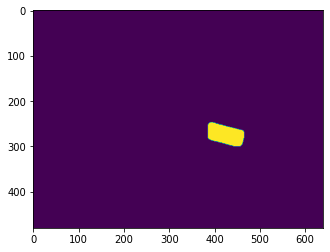

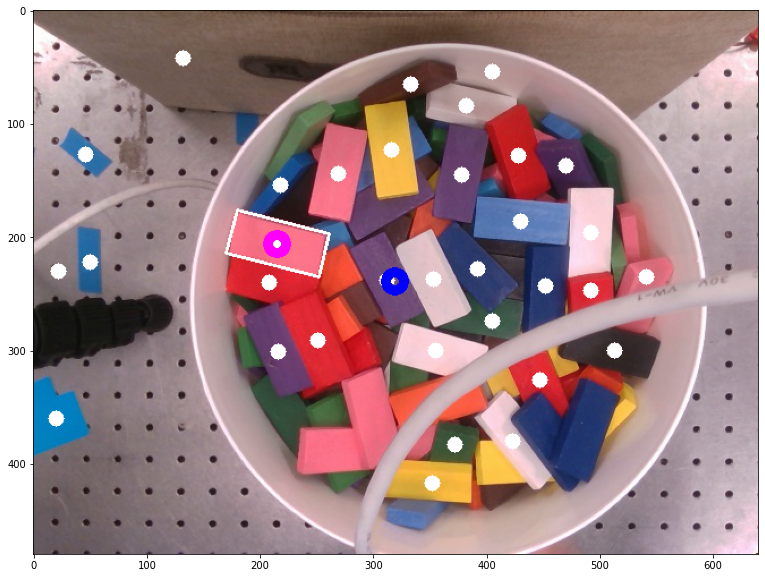

rotation 111
rotation, -76.67546873810922
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [273, 424]
stone_pose_msg is  header: 
  seq: 82
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.05471923168124273
y: 0.018666532847807654
z: 0.328
yaw: -1.3382393849899876
pitch: 0
normal: [ 0.22427763 -0.74056231 -2.88087018]
depth[1] 83.13
54
Mask R-CNN: 32 objects detected tensor([0.9928, 0.9923, 0.9911, 0.9909, 0.9906, 0.9905, 0.9904, 0.9898, 0.9890,
        0.9882, 0.9862, 0.9854, 0.9847, 0.9829, 0.9817, 0.9813, 0.9809, 0.9808,
        0.9801, 0.9801, 0.9798, 0.9772, 0.9763, 0.9748, 0.9732, 0.9729, 0.9724,
        0.9709, 0.9709, 0.9590, 0.9588, 0.9536, 0.9450, 0.9410, 0.9356, 0.9335,
        0.9325, 0.9257, 0.9205, 0.9120, 0.9062, 0.8944, 0.8842, 0.8548, 0.8497,
        0.8145, 0.8106, 0.8044, 0.7321, 0.6749, 0.6748, 0.6590, 0.6503, 0.6436,
        0.6305, 0.6237, 0.5975, 0.5884, 0.5787, 0.5556, 0.5302, 0.4

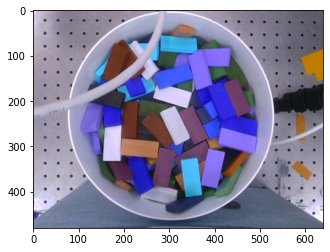

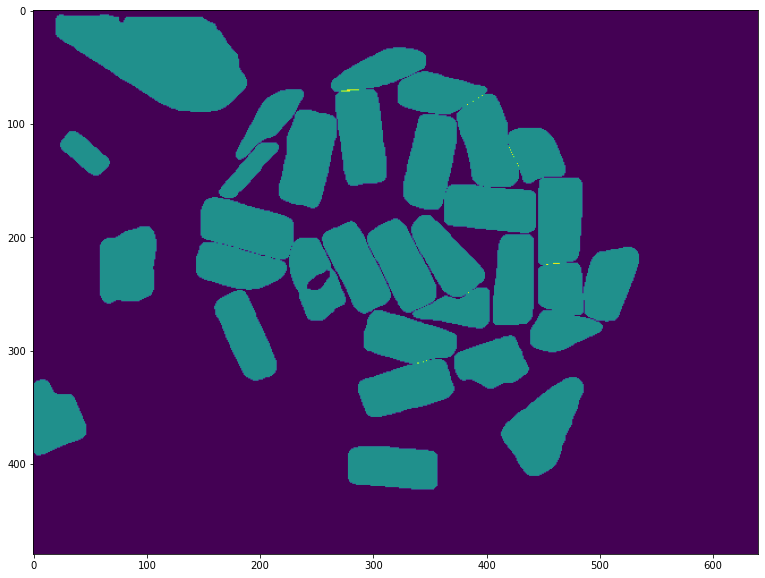

depth 0.332
most_center_point [345, 288]
most_center_mask


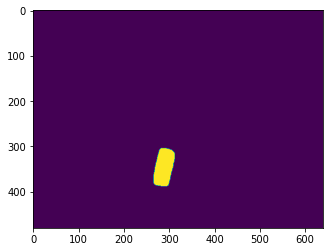

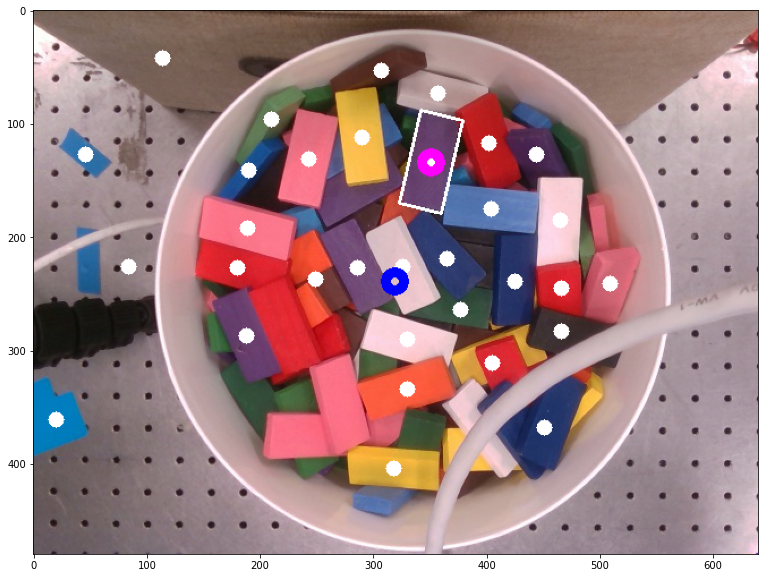

rotation 222
rotation, -166.32869286780416
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [345, 288]
stone_pose_msg is  header: 
  seq: 83
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.018379923669891926
y: 0.05796666673317704
z: 0.332
yaw: -2.9029833310815922
pitch: 0
normal: [ 0.36498087 -0.11075766 -2.92287865]
depth[1] 84.15
55
Mask R-CNN: 29 objects detected tensor([0.9933, 0.9930, 0.9903, 0.9878, 0.9876, 0.9875, 0.9874, 0.9871, 0.9869,
        0.9845, 0.9839, 0.9833, 0.9821, 0.9804, 0.9768, 0.9765, 0.9759, 0.9745,
        0.9735, 0.9729, 0.9711, 0.9702, 0.9702, 0.9670, 0.9651, 0.9641, 0.9616,
        0.9513, 0.9506, 0.9453, 0.9406, 0.9367, 0.9351, 0.9347, 0.9314, 0.9268,
        0.9187, 0.9101, 0.9003, 0.8587, 0.8477, 0.8465, 0.8307, 0.8225, 0.8174,
        0.8089, 0.7883, 0.7513, 0.7452, 0.7348, 0.7347, 0.7001, 0.6721, 0.6292,
        0.5745, 0.5643, 0.5618, 0.5546, 0.5493, 0.5331, 0.5329, 0

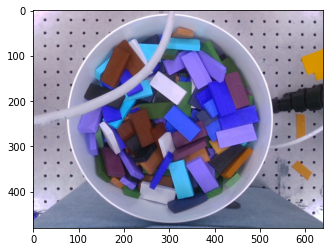

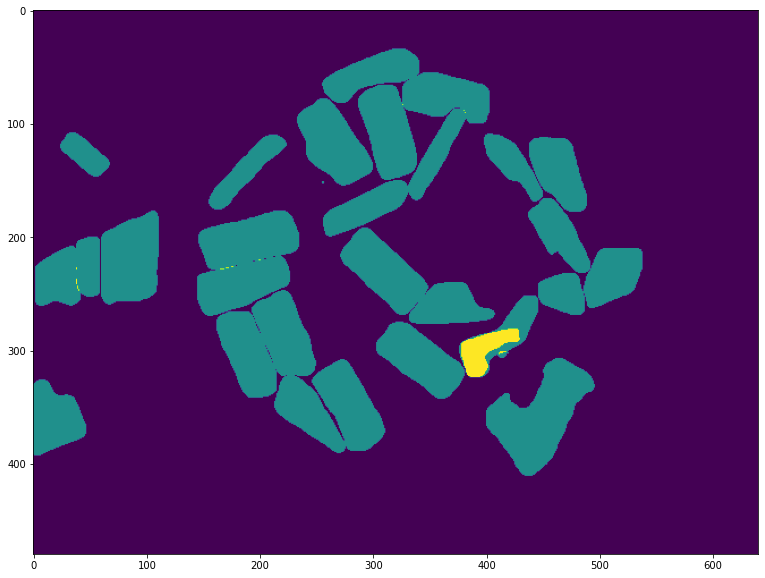

depth 0.338
depth 0.334
most_center_point [249, 329]
most_center_mask


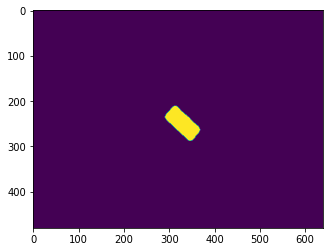

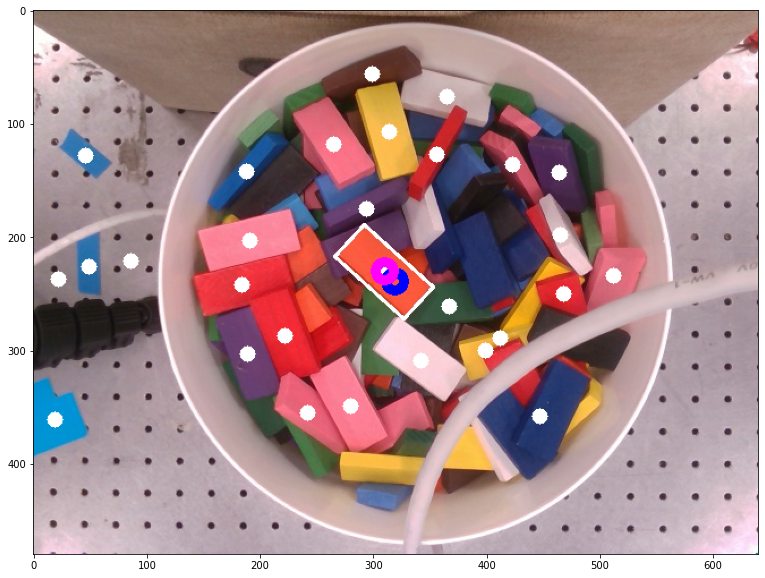

rotation 111
rotation, -47.12109639666146
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [249, 329]
stone_pose_msg is  header: 
  seq: 84
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.0038817392870312407
y: 0.005905370579139023
z: 0.334
yaw: -0.8224182792713783
pitch: 0
normal: [-0.77443123  0.19626241 -2.88502406]
depth[1] 84.405
56
Mask R-CNN: 29 objects detected tensor([0.9908, 0.9905, 0.9900, 0.9899, 0.9898, 0.9898, 0.9890, 0.9869, 0.9864,
        0.9862, 0.9856, 0.9845, 0.9833, 0.9827, 0.9806, 0.9769, 0.9767, 0.9751,
        0.9707, 0.9694, 0.9683, 0.9658, 0.9643, 0.9617, 0.9616, 0.9609, 0.9555,
        0.9538, 0.9534, 0.9373, 0.9326, 0.9190, 0.9106, 0.8949, 0.8946, 0.8916,
        0.8908, 0.8771, 0.8731, 0.8614, 0.8601, 0.8598, 0.8547, 0.8311, 0.8265,
        0.8247, 0.8185, 0.7885, 0.7753, 0.7687, 0.7554, 0.7196, 0.7182, 0.7031,
        0.7021, 0.6582, 0.6522, 0.6201, 0.5890, 0.5812, 0.5686, 

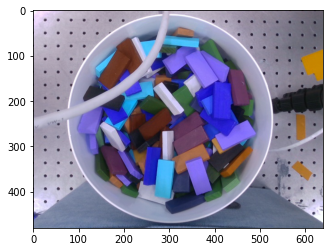

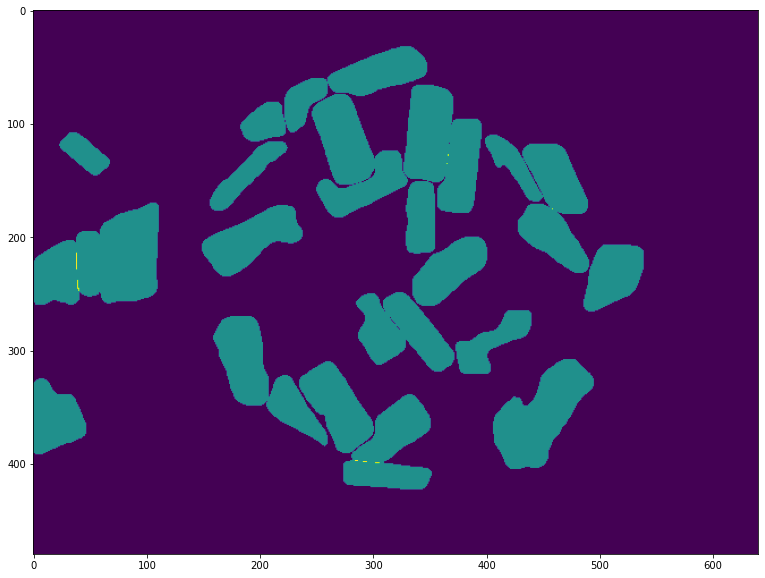

depth 0.33
depth 0.329
most_center_point [129, 370]
most_center_mask


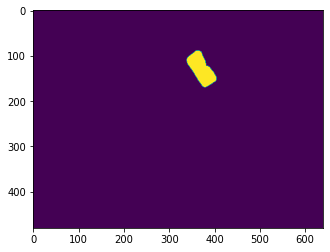

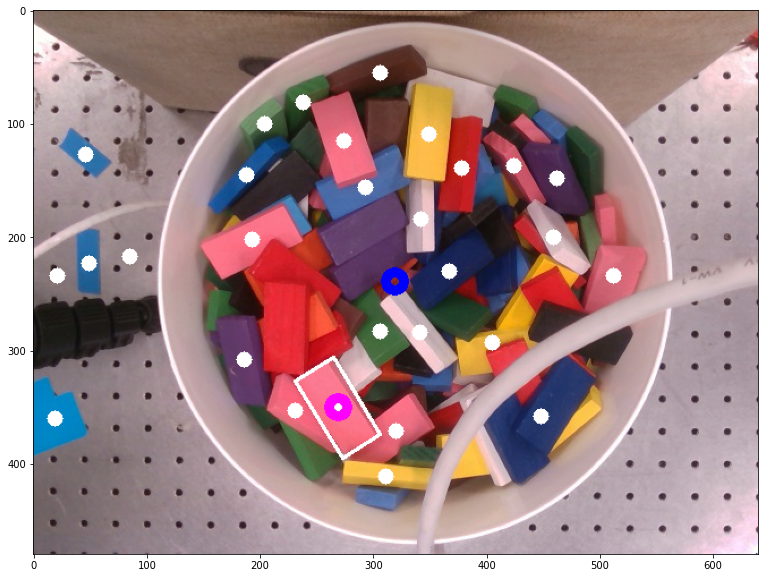

rotation 111
rotation, -32.47119229084849
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [129, 370]
stone_pose_msg is  header: 
  seq: 85
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.025861098857202232
y: -0.058715414076919235
z: 0.329
yaw: -0.5667292175235064
pitch: 0
normal: [ 0.40126722 -0.6221634  -2.88612844]
depth[1] 83.385
57
Mask R-CNN: 31 objects detected tensor([0.9954, 0.9925, 0.9913, 0.9902, 0.9884, 0.9873, 0.9869, 0.9864, 0.9850,
        0.9849, 0.9844, 0.9827, 0.9824, 0.9820, 0.9809, 0.9808, 0.9800, 0.9777,
        0.9770, 0.9766, 0.9766, 0.9760, 0.9720, 0.9704, 0.9701, 0.9697, 0.9689,
        0.9681, 0.9668, 0.9626, 0.9617, 0.9440, 0.9385, 0.9332, 0.9319, 0.9299,
        0.9273, 0.9221, 0.9078, 0.8967, 0.8576, 0.8490, 0.8230, 0.8221, 0.8192,
        0.7947, 0.7875, 0.7427, 0.7360, 0.7255, 0.7182, 0.7038, 0.6336, 0.5771,
        0.5504, 0.5475, 0.5232, 0.5017, 0.4914, 0.4603, 0.4274, 

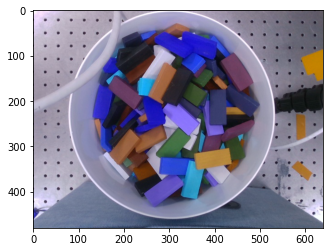

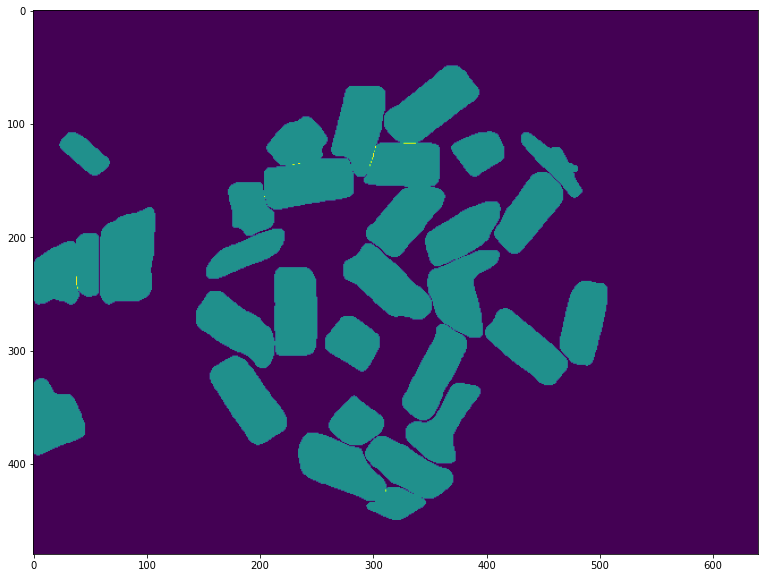

depth 0.318
most_center_point [230, 262]
most_center_mask


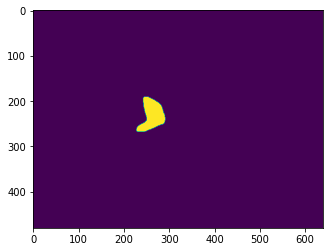

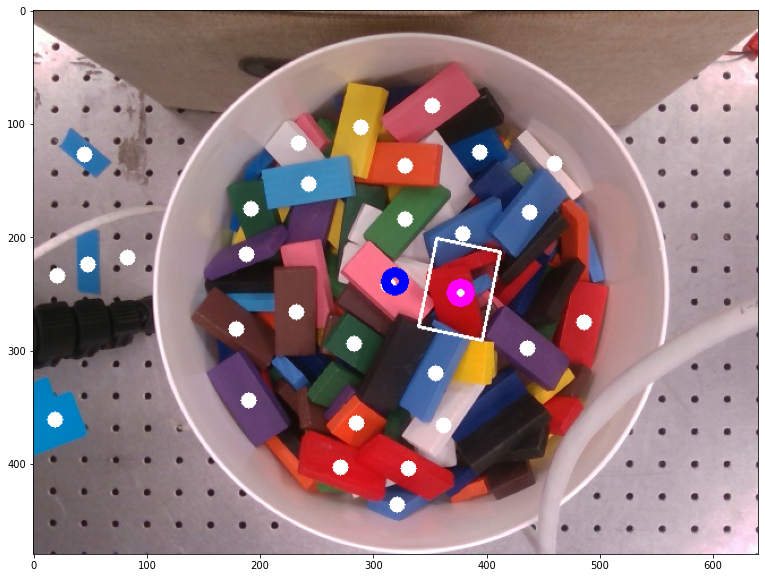

rotation 222
rotation, -167.90524292298792
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [230, 262]
stone_pose_msg is  header: 
  seq: 86
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.031112598675820002
y: -0.004253525614805208
z: 0.318
yaw: -2.930499320367047
pitch: 0
normal: [ 0.79794253 -1.96070276 -2.1227293 ]
depth[1] 80.58
58
Mask R-CNN: 28 objects detected tensor([0.9942, 0.9934, 0.9926, 0.9903, 0.9897, 0.9869, 0.9867, 0.9866, 0.9864,
        0.9817, 0.9815, 0.9797, 0.9796, 0.9788, 0.9783, 0.9782, 0.9781, 0.9780,
        0.9776, 0.9754, 0.9751, 0.9738, 0.9723, 0.9716, 0.9693, 0.9636, 0.9557,
        0.9548, 0.9475, 0.9463, 0.9408, 0.9402, 0.9322, 0.9202, 0.9121, 0.9073,
        0.9065, 0.9038, 0.8533, 0.8489, 0.8255, 0.8074, 0.8068, 0.7939, 0.7895,
        0.7866, 0.7754, 0.7752, 0.7480, 0.7265, 0.7231, 0.7210, 0.6438, 0.6433,
        0.6101, 0.5923, 0.5687, 0.5571, 0.5426, 0.5089, 0.4771, 

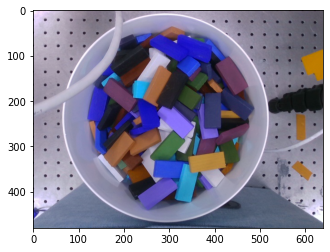

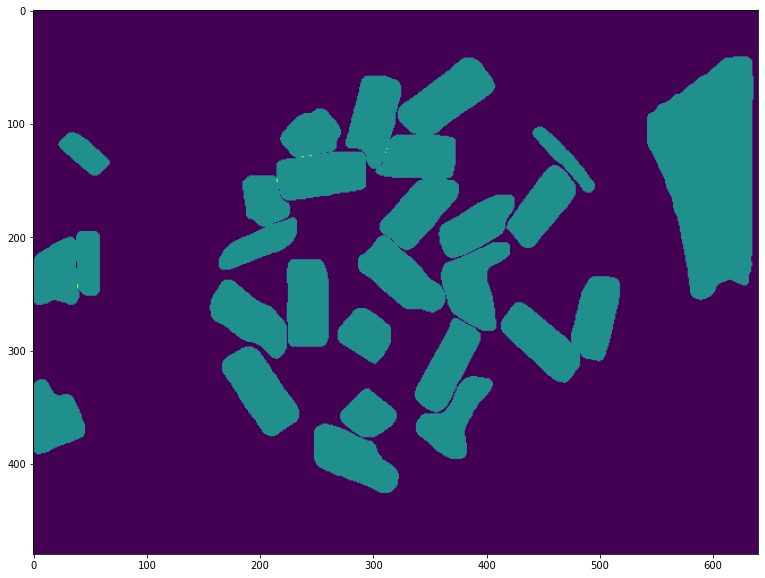

depth 0.324
depth 0.329
most_center_point [244, 314]
most_center_mask


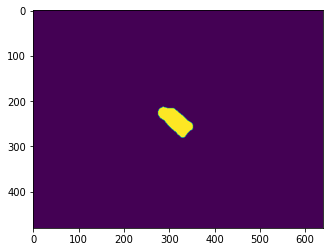

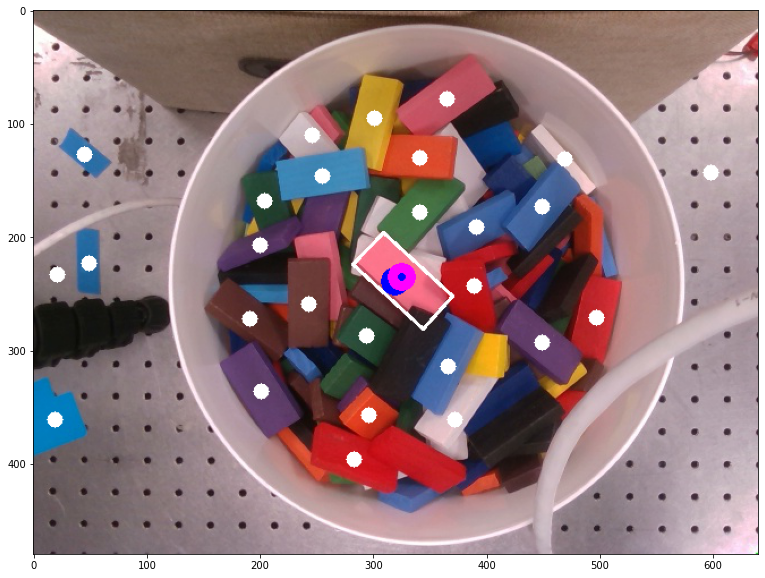

rotation 111
rotation, -48.12213046211571
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [244, 314]
stone_pose_msg is  header: 
  seq: 87
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.00423885940195119
y: 0.0031281176235845765
z: 0.329
yaw: -0.8398896196381795
pitch: 0
normal: [-0.78814982  0.37612707 -2.86635608]
depth[1] 82.875
59
Mask R-CNN: 33 objects detected tensor([0.9919, 0.9903, 0.9882, 0.9882, 0.9868, 0.9868, 0.9866, 0.9862, 0.9857,
        0.9833, 0.9833, 0.9824, 0.9824, 0.9823, 0.9821, 0.9819, 0.9807, 0.9794,
        0.9777, 0.9773, 0.9755, 0.9753, 0.9746, 0.9693, 0.9681, 0.9642, 0.9614,
        0.9608, 0.9607, 0.9605, 0.9542, 0.9514, 0.9511, 0.9414, 0.9383, 0.9380,
        0.9335, 0.9289, 0.8791, 0.8375, 0.8206, 0.7569, 0.7518, 0.7481, 0.7131,
        0.6681, 0.6269, 0.6144, 0.6120, 0.6061, 0.5703, 0.4553, 0.4357, 0.4226,
        0.4196, 0.3572, 0.3560, 0.3337, 0.3281, 0.3115, 0.2939, 

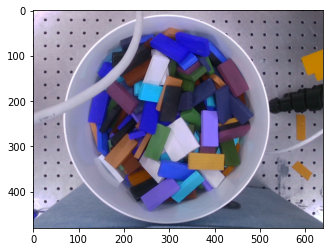

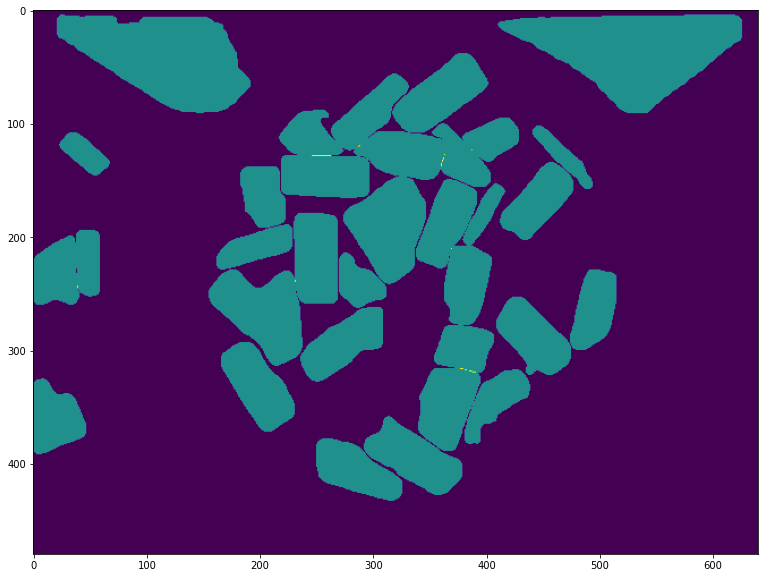

depth 0.337
depth 0.345
most_center_point [287, 324]
most_center_mask


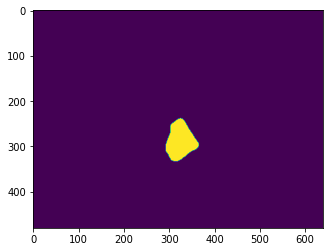

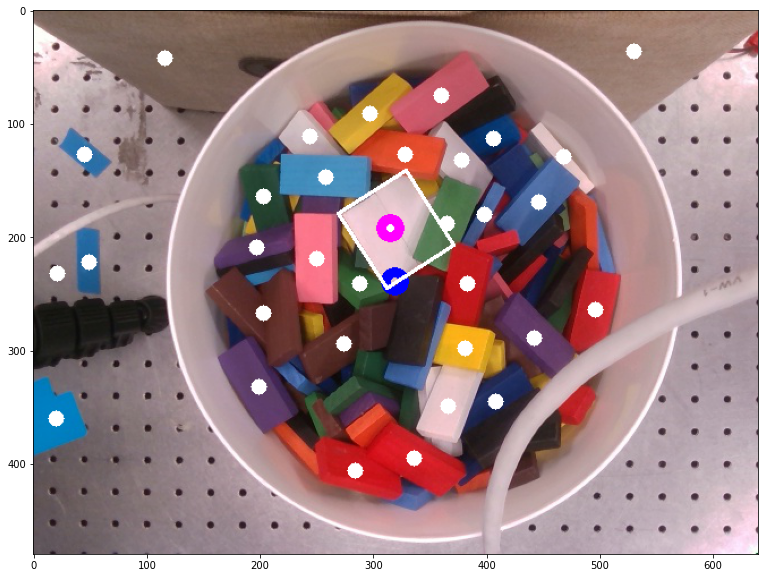

rotation 111
rotation, -32.78428086586915
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [287, 324]
stone_pose_msg is  header: 
  seq: 88
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.001191385820038119
y: 0.0275289245273607
z: 0.345
yaw: -0.5721936440079941
pitch: 0
normal: [-0.85665988 -0.42570618 -2.83302557]
depth[1] 86.7
60
Mask R-CNN: 32 objects detected tensor([0.9925, 0.9908, 0.9899, 0.9899, 0.9878, 0.9875, 0.9873, 0.9870, 0.9864,
        0.9856, 0.9847, 0.9840, 0.9835, 0.9832, 0.9829, 0.9809, 0.9806, 0.9782,
        0.9781, 0.9779, 0.9774, 0.9758, 0.9744, 0.9741, 0.9737, 0.9671, 0.9635,
        0.9622, 0.9603, 0.9574, 0.9534, 0.9509, 0.9349, 0.9293, 0.9220, 0.9205,
        0.9121, 0.8938, 0.8596, 0.8590, 0.8511, 0.8248, 0.8207, 0.8193, 0.8168,
        0.8031, 0.7996, 0.7682, 0.7378, 0.7352, 0.7034, 0.6977, 0.6538, 0.6407,
        0.6302, 0.6121, 0.5952, 0.5488, 0.5123, 0.5036, 0.4986, 0.480

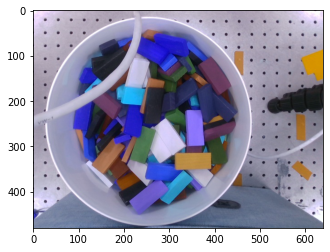

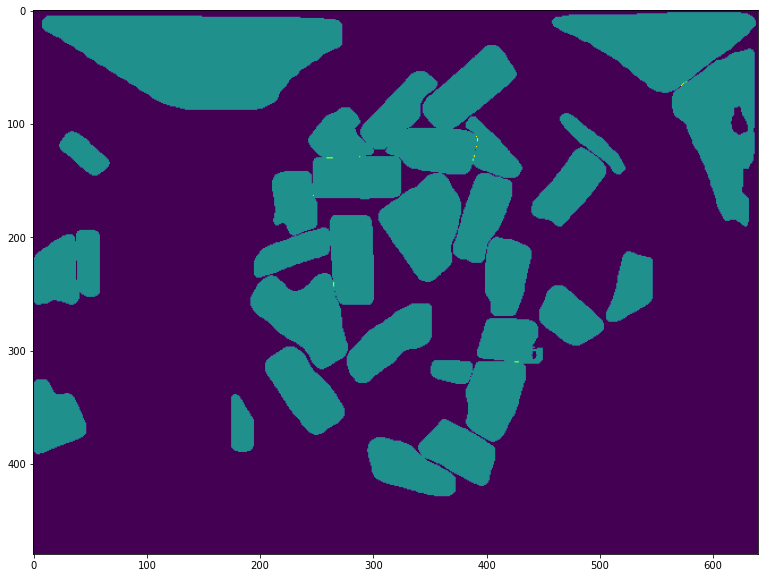

depth 0.332
depth 0.345
depth 0.345
most_center_point [289, 293]
most_center_mask


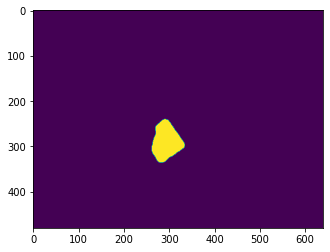

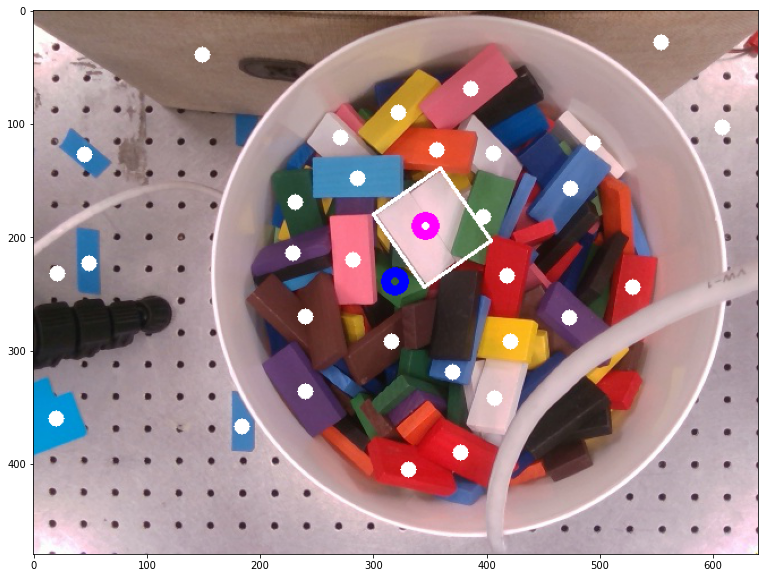

rotation 111
rotation, -34.796026278268315
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [289, 293]
stone_pose_msg is  header: 
  seq: 89
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.016281424296204054
y: 0.02865677009028782
z: 0.345
yaw: -0.6073052251662507
pitch: 0
normal: [-0.99318528 -0.42876052 -2.79101922]
depth[1] 86.7
61
Mask R-CNN: 35 objects detected tensor([0.9917, 0.9916, 0.9885, 0.9874, 0.9845, 0.9838, 0.9832, 0.9825, 0.9811,
        0.9804, 0.9800, 0.9799, 0.9793, 0.9793, 0.9786, 0.9784, 0.9769, 0.9766,
        0.9761, 0.9748, 0.9743, 0.9730, 0.9724, 0.9694, 0.9690, 0.9685, 0.9669,
        0.9642, 0.9613, 0.9592, 0.9586, 0.9544, 0.9540, 0.9512, 0.9504, 0.9458,
        0.9452, 0.9422, 0.9228, 0.9193, 0.8694, 0.8482, 0.8400, 0.8103, 0.8045,
        0.8025, 0.7635, 0.7355, 0.7203, 0.7066, 0.7044, 0.6850, 0.6681, 0.6329,
        0.5856, 0.5855, 0.5765, 0.5309, 0.4839, 0.4449, 0.4387, 0.

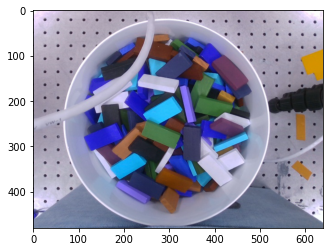

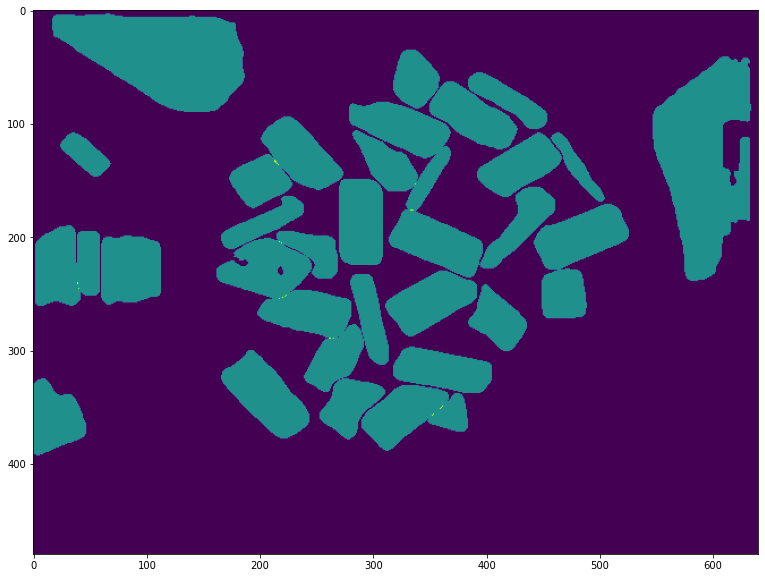

depth 0.337
most_center_point [292, 350]
most_center_mask


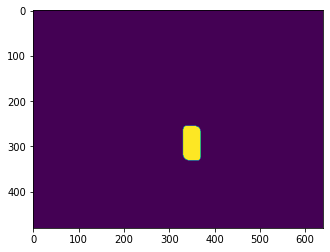

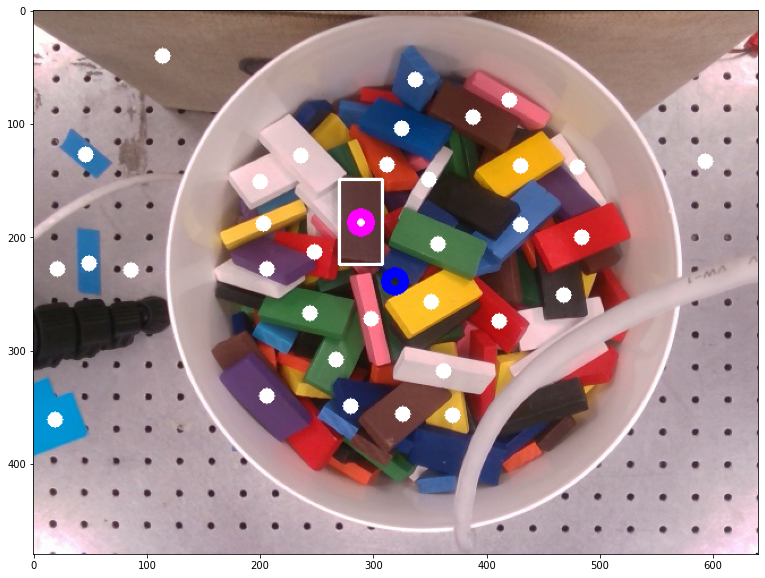

rotation 222
rotation, 180.0
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [292, 350]
stone_pose_msg is  header: 
  seq: 90
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.015478557260444337
y: 0.029644804210106252
z: 0.337
yaw: 3.141592653589793
pitch: 0
normal: [-0.91966294  0.90571831 -2.69739529]
depth[1] 83.895
62
Mask R-CNN: 32 objects detected tensor([0.9922, 0.9909, 0.9904, 0.9888, 0.9876, 0.9867, 0.9846, 0.9838, 0.9821,
        0.9820, 0.9815, 0.9811, 0.9810, 0.9803, 0.9795, 0.9769, 0.9768, 0.9740,
        0.9735, 0.9724, 0.9720, 0.9717, 0.9706, 0.9705, 0.9705, 0.9705, 0.9658,
        0.9620, 0.9618, 0.9604, 0.9593, 0.9545, 0.9442, 0.9416, 0.9336, 0.9325,
        0.9277, 0.9153, 0.8878, 0.8864, 0.8740, 0.8583, 0.8316, 0.8149, 0.7788,
        0.7788, 0.6883, 0.6730, 0.6713, 0.6516, 0.6423, 0.6074, 0.5936, 0.5682,
        0.5681, 0.5634, 0.5363, 0.5133, 0.5088, 0.4899, 0.4844, 0.4819, 0.4423,


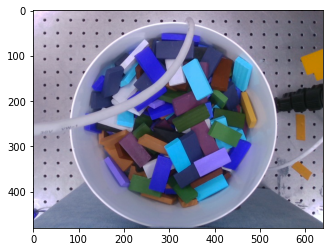

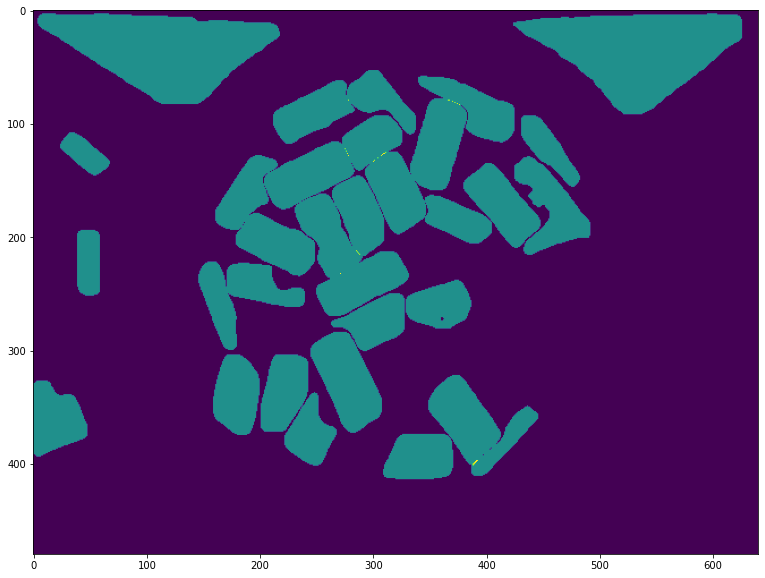

depth 0.349
depth 0.35
depth 0.317
most_center_point [152, 362]
most_center_mask


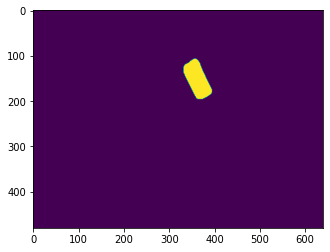

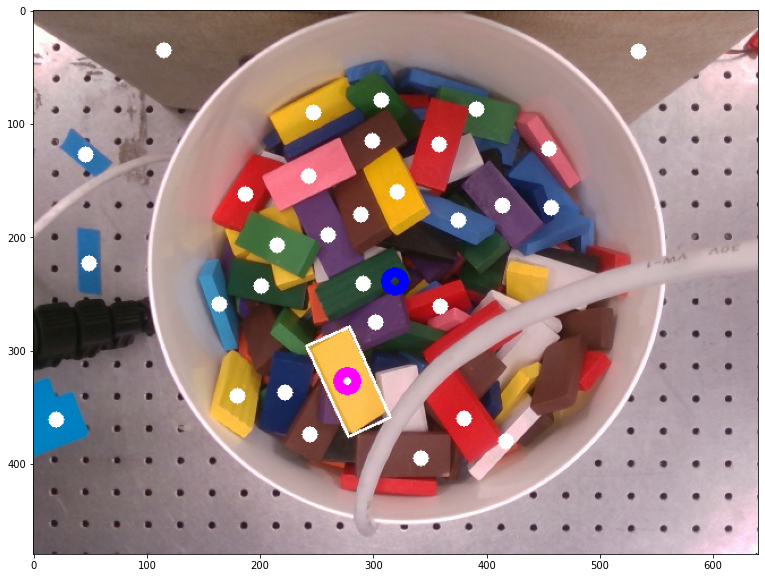

rotation 111
rotation, -24.67686317033706
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [152, 362]
stone_pose_msg is  header: 
  seq: 91
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.020774681544064314
y: -0.04465625031176734
z: 0.317
yaw: -0.430692511386508
pitch: 0
normal: [-0.88043288  0.24485782 -2.81290307]
depth[1] 79.815
63
Mask R-CNN: 29 objects detected tensor([0.9926, 0.9905, 0.9903, 0.9901, 0.9885, 0.9880, 0.9863, 0.9862, 0.9837,
        0.9802, 0.9800, 0.9791, 0.9748, 0.9746, 0.9726, 0.9720, 0.9709, 0.9704,
        0.9704, 0.9696, 0.9673, 0.9617, 0.9613, 0.9591, 0.9588, 0.9586, 0.9585,
        0.9553, 0.9514, 0.9466, 0.9409, 0.9381, 0.9263, 0.9169, 0.9165, 0.9162,
        0.9159, 0.9151, 0.9129, 0.9021, 0.8880, 0.8775, 0.8486, 0.8398, 0.8273,
        0.8174, 0.7947, 0.7822, 0.7668, 0.7494, 0.7462, 0.7071, 0.7032, 0.6915,
        0.6381, 0.6368, 0.6085, 0.6028, 0.5358, 0.5349, 0.5066, 0.

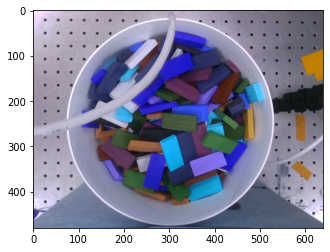

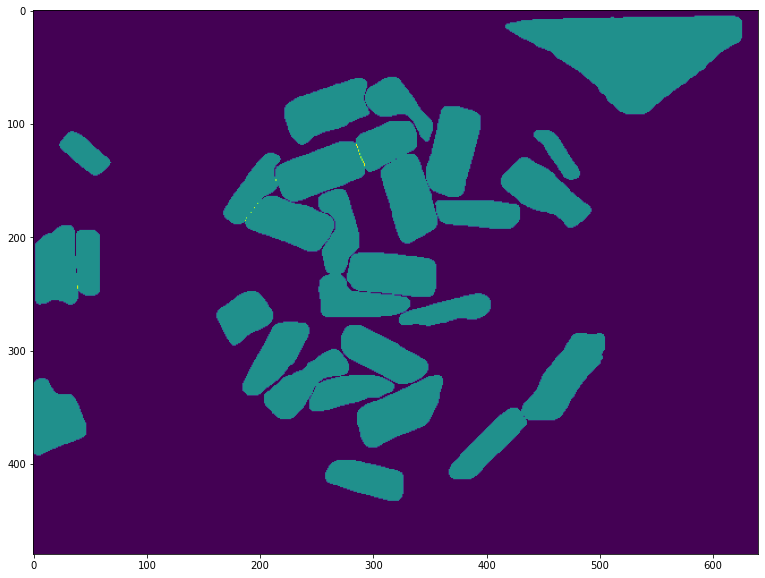

depth 0.335
most_center_point [246, 321]
most_center_mask


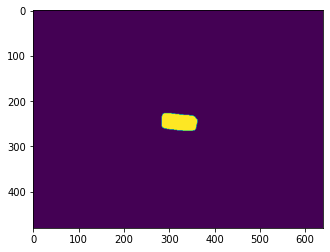

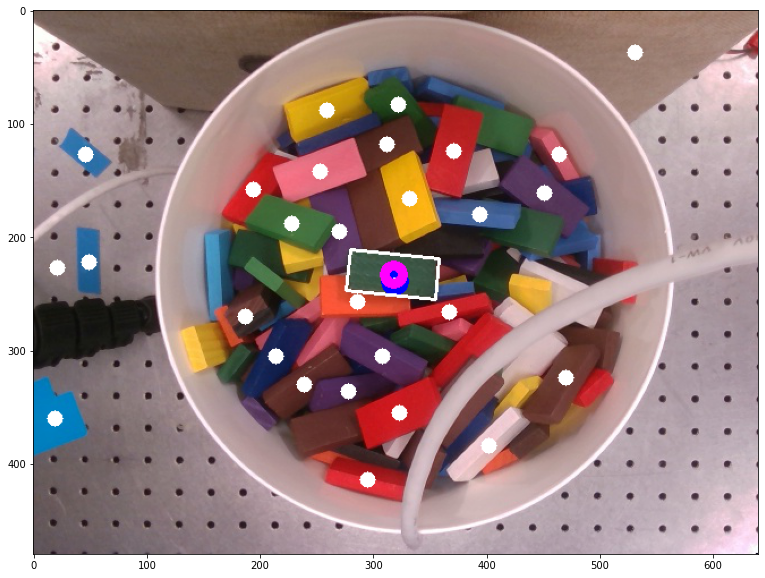

rotation 111
rotation, -85.23635830927383
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [246, 321]
stone_pose_msg is  header: 
  seq: 92
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: -0.0004850521202176268
y: 0.004280319748590812
z: 0.335
yaw: -1.4876550949064553
pitch: 0
normal: [-0.95600402  0.67130526 -2.75680529]
depth[1] 83.895
64
Mask R-CNN: 33 objects detected tensor([0.9902, 0.9901, 0.9854, 0.9852, 0.9847, 0.9836, 0.9829, 0.9819, 0.9816,
        0.9813, 0.9810, 0.9799, 0.9789, 0.9786, 0.9779, 0.9768, 0.9752, 0.9738,
        0.9717, 0.9717, 0.9708, 0.9704, 0.9683, 0.9652, 0.9640, 0.9631, 0.9628,
        0.9620, 0.9612, 0.9576, 0.9552, 0.9509, 0.9509, 0.9486, 0.9468, 0.9410,
        0.9401, 0.9393, 0.9388, 0.9382, 0.9351, 0.9307, 0.9273, 0.9250, 0.9122,
        0.8971, 0.8819, 0.8785, 0.8622, 0.8541, 0.8429, 0.8333, 0.7891, 0.7656,
        0.7260, 0.7154, 0.6862, 0.6620, 0.5748, 0.5707, 0.5571,

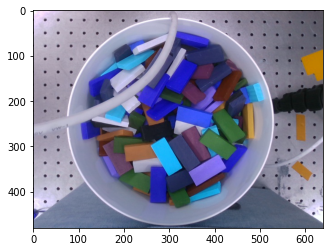

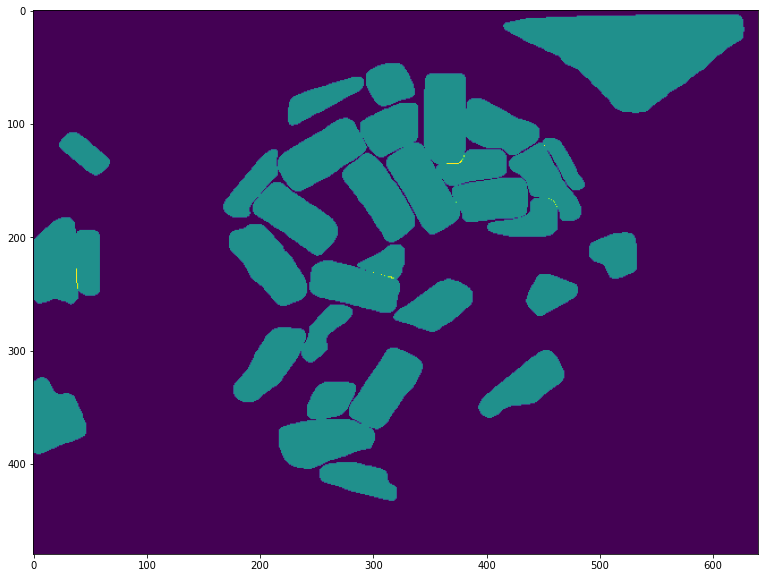

depth 0.347
most_center_point [314, 333]
most_center_mask


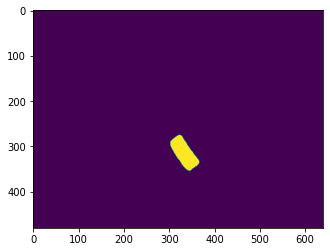

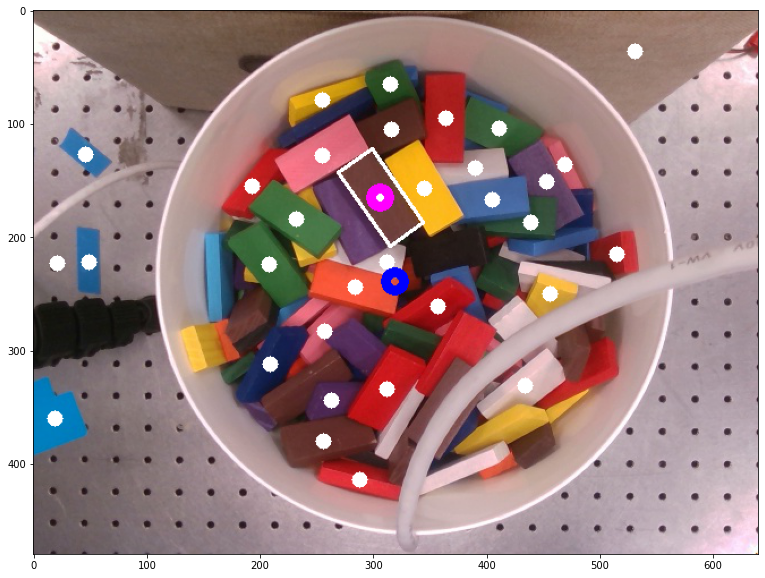

rotation 111
rotation, -35.90972307917768
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [314, 333]
stone_pose_msg is  header: 
  seq: 93
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.006300450982624998
y: 0.04300269376964134
z: 0.347
yaw: -0.6267429012110469
pitch: 0
normal: [-0.01197813  0.04252875 -2.87877061]
depth[1] 88.23
65
Mask R-CNN: 28 objects detected tensor([0.9925, 0.9904, 0.9902, 0.9898, 0.9878, 0.9868, 0.9863, 0.9844, 0.9842,
        0.9839, 0.9831, 0.9825, 0.9822, 0.9817, 0.9815, 0.9806, 0.9800, 0.9791,
        0.9748, 0.9727, 0.9703, 0.9701, 0.9698, 0.9658, 0.9645, 0.9642, 0.9555,
        0.9555, 0.9481, 0.9472, 0.9468, 0.9445, 0.9435, 0.9375, 0.9360, 0.9224,
        0.9199, 0.9150, 0.9145, 0.9137, 0.9085, 0.9060, 0.9054, 0.8943, 0.8882,
        0.8863, 0.8815, 0.8808, 0.8674, 0.8354, 0.8189, 0.8184, 0.8087, 0.7552,
        0.7465, 0.7051, 0.6813, 0.6802, 0.6705, 0.6573, 0.6406, 0.6

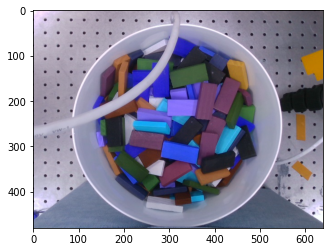

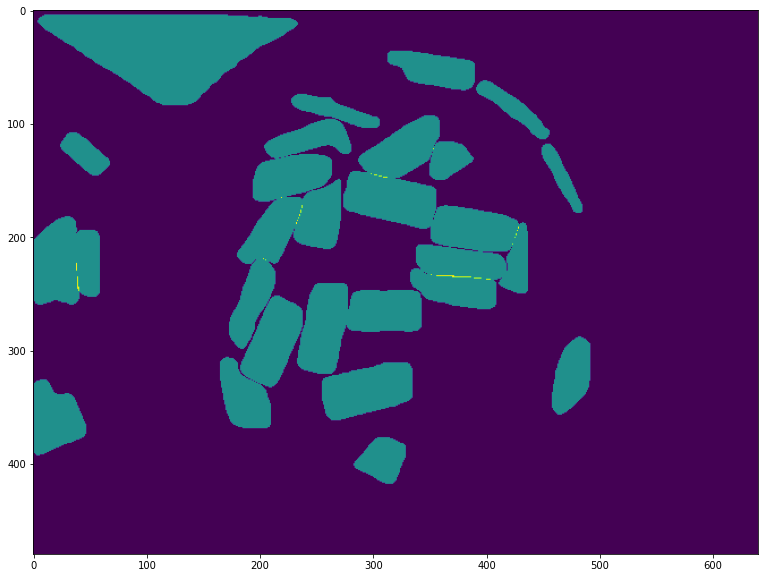

depth 0.352
depth 0.332
depth 0.342
most_center_point [312, 323]
most_center_mask


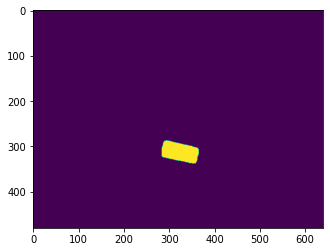

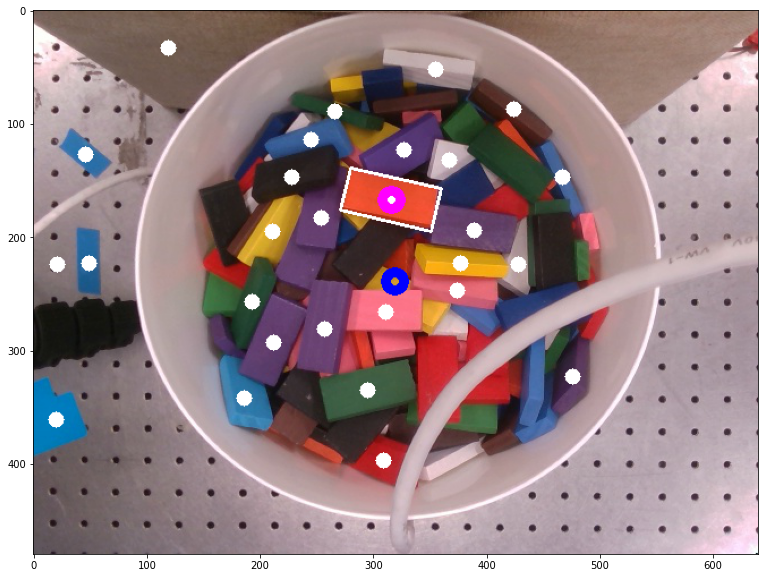

rotation 111
rotation, -76.67546873810922
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [312, 323]
stone_pose_msg is  header: 
  seq: 94
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.0006222881163430871
y: 0.04126502020252407
z: 0.342
yaw: -1.3382393849899876
pitch: 0
normal: [-0.27310024  0.50621813 -2.92589978]
depth[1] 86.7
66
Mask R-CNN: 35 objects detected tensor([0.9932, 0.9908, 0.9908, 0.9901, 0.9896, 0.9891, 0.9887, 0.9885, 0.9879,
        0.9875, 0.9869, 0.9868, 0.9861, 0.9857, 0.9849, 0.9829, 0.9821, 0.9800,
        0.9791, 0.9786, 0.9776, 0.9775, 0.9751, 0.9746, 0.9737, 0.9683, 0.9683,
        0.9649, 0.9640, 0.9637, 0.9615, 0.9614, 0.9589, 0.9548, 0.9536, 0.9485,
        0.9460, 0.9402, 0.9333, 0.9177, 0.9150, 0.8781, 0.8486, 0.8462, 0.8412,
        0.8331, 0.8273, 0.8213, 0.7533, 0.7360, 0.7087, 0.6885, 0.6811, 0.6589,
        0.6477, 0.6391, 0.6122, 0.5790, 0.5488, 0.5319, 0.5296, 0.5

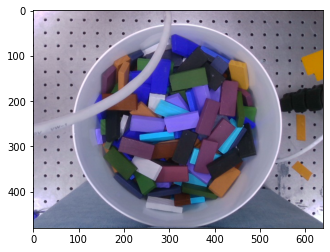

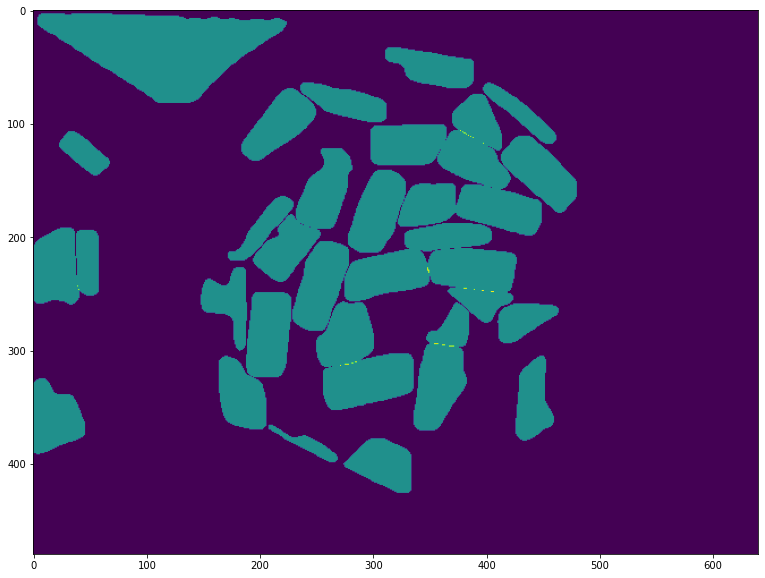

depth 0.355
most_center_point [301, 335]
most_center_mask


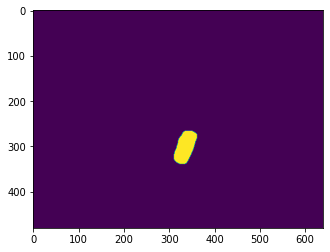

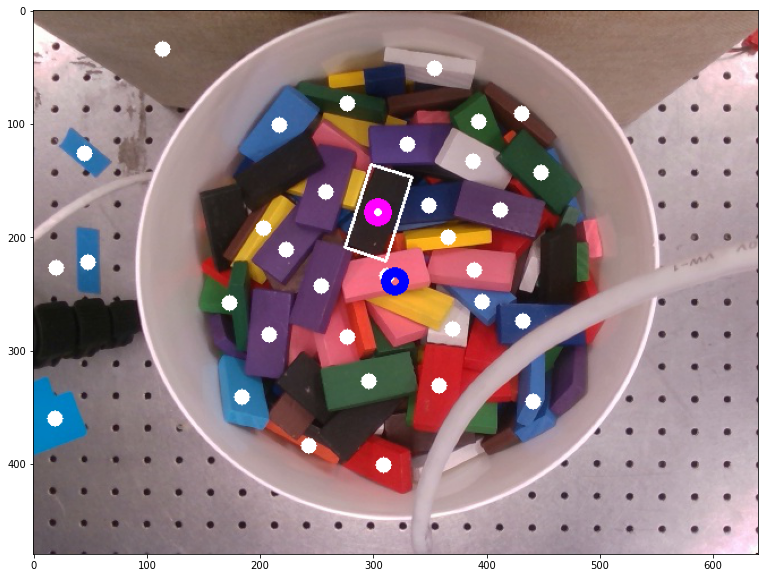

rotation 222
rotation, -163.00917670801385
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [301, 335]
stone_pose_msg is  header: 
  seq: 95
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.007605659135431995
y: 0.03645062153938245
z: 0.355
yaw: -2.845046844520093
pitch: 0
normal: [-1.30278236  0.15841859 -2.66120297]
depth[1] 89.25
67
Mask R-CNN: 26 objects detected tensor([0.9919, 0.9915, 0.9903, 0.9899, 0.9892, 0.9890, 0.9877, 0.9871, 0.9866,
        0.9833, 0.9833, 0.9807, 0.9800, 0.9798, 0.9786, 0.9765, 0.9739, 0.9714,
        0.9688, 0.9678, 0.9670, 0.9642, 0.9577, 0.9562, 0.9555, 0.9505, 0.9483,
        0.9411, 0.9410, 0.9407, 0.9403, 0.9363, 0.9344, 0.9242, 0.9173, 0.9120,
        0.9111, 0.9089, 0.9082, 0.9035, 0.9001, 0.8847, 0.8767, 0.8748, 0.8669,
        0.8662, 0.8435, 0.8174, 0.7894, 0.7874, 0.7555, 0.7246, 0.7194, 0.7129,
        0.7115, 0.7067, 0.6984, 0.6885, 0.6724, 0.6611, 0.6557, 0.6

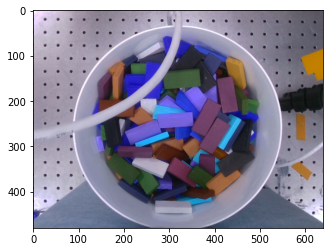

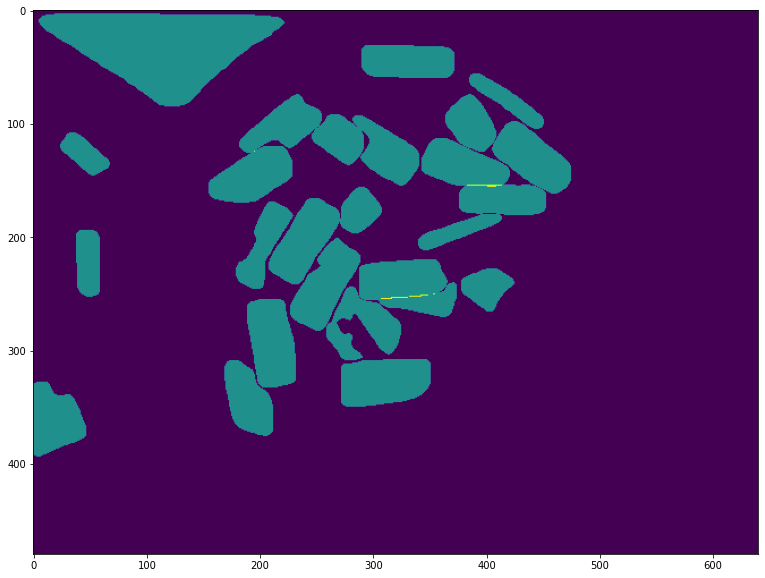

depth 0.352
depth 0.349
depth 0.344
most_center_point [236, 381]
most_center_mask


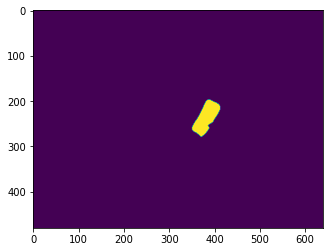

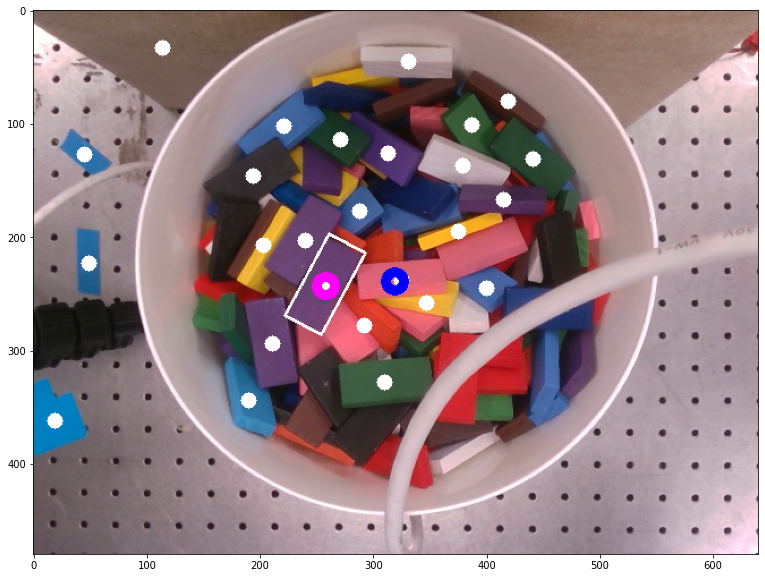

rotation 222
rotation, -152.02052561151984
compute normal
Recompute the normal of the downsampled point cloud
Normal as a numpy array
finished
most_center_point [236, 381]
stone_pose_msg is  header: 
  seq: 96
  stamp: 
    secs: 0
    nsecs:         0
  frame_id: ''
x: 0.033222234609084904
y: -0.0012275688132887712
z: 0.344
yaw: -2.6532587025333876
pitch: 0
normal: [ 0.06382237  0.69116849 -2.9153572 ]
depth[1] 86.445


KeyboardInterrupt: 

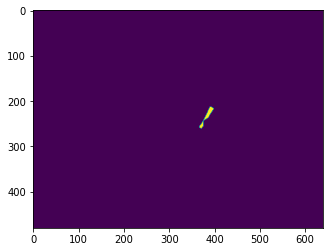

In [17]:
#edge_detection = True
edge_detection = False
#if (True):
while (True):
    if(is_detect == 1):
        
        pose_pub = rospy.Publisher('/stone_pose', stone_pose, queue_size=10)
        
        img_index = str(img_index)
              
        
        # instance segmentation
        #image = skimage.io.imread("../log/JPEGImages/150.jpeg")
        #image = skimage.io.imread("../log/JPEGImages/"+img_index+".jpeg")
        #image = scipy.misc.imread("../log/JPEGImages/"+img_index+".jpeg")
        image = skimage.io.imread("../samples/stones/JPEGImages/"+img_index+".jpeg")
        
        plt.imshow(image[:,:,::-1])
        #plt.show()
        
        depth_image = cv2.imread("../samples/stones/depth/"+img_index+".jpeg")
        depth_array = np.load("../samples/stones/depth/"+img_index+".npy")
    
        
        masks,full_mask = dig_maskRCNN.find_mask(image,edge_detection,device, model)
        
        
        # Visualize results
        #r = results[0]

        
        
        #mask_center, pose, depth_copy = generate_stone_pose(depth_image, depth_array, r)
        
        #full_mask = np.sum(r['masks'],axis = 2)
        #print('full_mask.shape',full_mask.shape)
        #center = find_center(full_mask)
        
        center = [int(image.shape[0]/2), int(image.shape[1]/2)]
        #plt.imshow(depth_image)
        #plt.show()
        
        
        img_copy = image.copy()
        cv2.circle(img_copy, (int(center[1]), int(center[0])), 8, (255, 0, 255), 8)
        
        
        #visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
        #                           class_names, r['scores'])
        
        
        #visualize.display_mask(image, r['masks'])

        #print('img_copy2')
        #plt.imshow(img_copy)
        #plt.show()
        
        
        #depth_image2 = skimage.io.imread("../samples/stones/depth/"+img_index+".jpeg")
        
        mask_max, most_center_point, depth,box = find_mask(image,depth_array - 10.0 * np.ones(depth_array.shape) , masks,center,[1,1])
        
        
        pose2 = find_pose(depth_array , mask_max, most_center_point, depth, box )
        #pose2 = find_pose(mask_max, mask_center[::-1], depth_image2, box_max )
        
        print('compute normal')
        normal,depth2 = compute_normal(depth_array ,mask_max)
        
        print('finished')
        stone_pose_msg = stone_pose()
        stone_pose_msg.x = pose2['x']
        stone_pose_msg.y = pose2['y']
        stone_pose_msg.z = pose2['z'] #depth2#
        stone_pose_msg.yaw = pose2['yaw']
        stone_pose_msg.pitch = 0 #pose['pitch']
        stone_pose_msg.normal = normal#0,0,0]#pose['normal']

        print('most_center_point',most_center_point)
        pose_pub.publish(stone_pose_msg)
        print('stone_pose_msg is ', stone_pose_msg)
        
        print('depth[1]',depth[1])

        
        is_detect = 0